# Tutorial on dimensionality reduction techniques
The tutorial aims at giving you the opportunity to work on experimental neural data and apply a selection of dimensionality reduction techniques. 
The breakdown of steps with cells should help in understanding how to approach from sorted data to visualization of the results. 
The outline of the structure is:
1) Data extraction and processing 
2) Evaluation processed data
3) Dimensionality reduction and comparison
4) TDE evalutation
5) PSTH and mean peristimuls dimred

### Question to add to reflect + modifications to test 
- what should we verify when we are doing binning and smoothing? 
- Can you appreciate the difference in activity between different neurons? 
- Evaluation dimred results and differneces between different techniques
- 


In [2]:
### CONVECTIONS COMMENTS ###

### TITLE ### -> CAPSLOCK
# explanation -> lower case
##? question to test ?## 
''' IS A SECTION FOR LATER USE'''

' IS A SECTION FOR LATER USE'

In [1]:
### import section ###
import os
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mat73 import loadmat
from scipy.stats import norm
from scipy.stats import binned_statistic
from sklearn.decomposition import PCA
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.decomposition import FactorAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.manifold import Isomap
from ica import ica1


In [2]:
### LOADING SECTION ###
# data downloaded from https://zenodo.org/records/3854034 

path_to_data=".\data\\"
if not os.path.exists(path_to_data):
    os.makedirs(path_to_data)

data_file=f"indy_20160930_05.mat"
sess_1 = loadmat(path_to_data+data_file)

cursor_pos_or = sess_1["cursor_pos"]            # projection 2D on the screen of the finger tip of the monkey
finger_pos_or = sess_1["finger_pos"]            # 3D coordinatess of the finger tip of the monkey OR also 6D where the other 3 are the angles 
t_points = sess_1["t"]                          # spiking time points
t = len(t_points)                               # number of time points (101501)
target_pos_or = sess_1["target_pos"]            # it is position on the 8x8 grid of the target in centimeters
wf = sess_1["wf"]                               # wave functions => it is the spike but with the voltage curve 
fs_kin_or = 250                                 # [Hz] sampling frequency of kinematic data (cursor etc)
spikes = sess_1["spikes"]                       # already spike sorted ## explain the structure below, than again in the 

file_name = os.path.basename(data_file)         ##### compact the 2 line in 1
session_name, _ = os.path.splitext(data_file)   # use it to save the plots with the name of the session


In [3]:
### STRUCTURE THE SPIKING TIME SERIES: FROM CHANNELS WITH UNSORTED TO ONLY SORTED NEURONS ###

neuron_spikes = []                                          # list of the spike timing of the neurons included the multiunit unsorted activity
neuron_spikes_sorted = []                                   # list of the spike timing of the sorted neurons without the multiunit activity
n_max_neurons = len(spikes[0])                              # maximum number of neurons per channel
n_channels = len(spikes)                                    # number of channels
n_neurons = 0
n_neurons_sorted = 0
threshold = 10                                               # threshold on the minumum amount of spikes to consider a neuron 
for i in range(n_channels):
    for j in range(n_max_neurons):
        if np.size(spikes[i][j]) > threshold:
            n_neurons += 1
            neuron_spikes.append(spikes[i][j])
            if j != 0:
               neuron_spikes_sorted.append(spikes[i][j])  
               n_neurons_sorted += 1

print(n_neurons, len(neuron_spikes_sorted))

# len(spikes) sono i canali di cui è già stato fatto il sorting
# len(spikes[0]) sono i neuroni per canale di cui il primo è multiunit activity, di cui il sorting non è riuscito a identificare unità e quindi rimaste diverse WF 
# le altre 2 o 4 componenti sono le unità identificate dal sorting
# len(spikes[0][0]) è il numero di spike per neurone (in particolare è lo spike timing)
# spikes[0][0][0] è il primo spike timing del primo neurone del primo canale (dove il primo neurone è il multiunit activity)

# in sorted there are no multi units, thus what we are interested in 

264 173


In [4]:
### SAVING SECTION FOR THE DATA PROCESSING ###
process_folder = "processing_folder"
if not os.path.exists(process_folder):
    os.makedirs(process_folder)

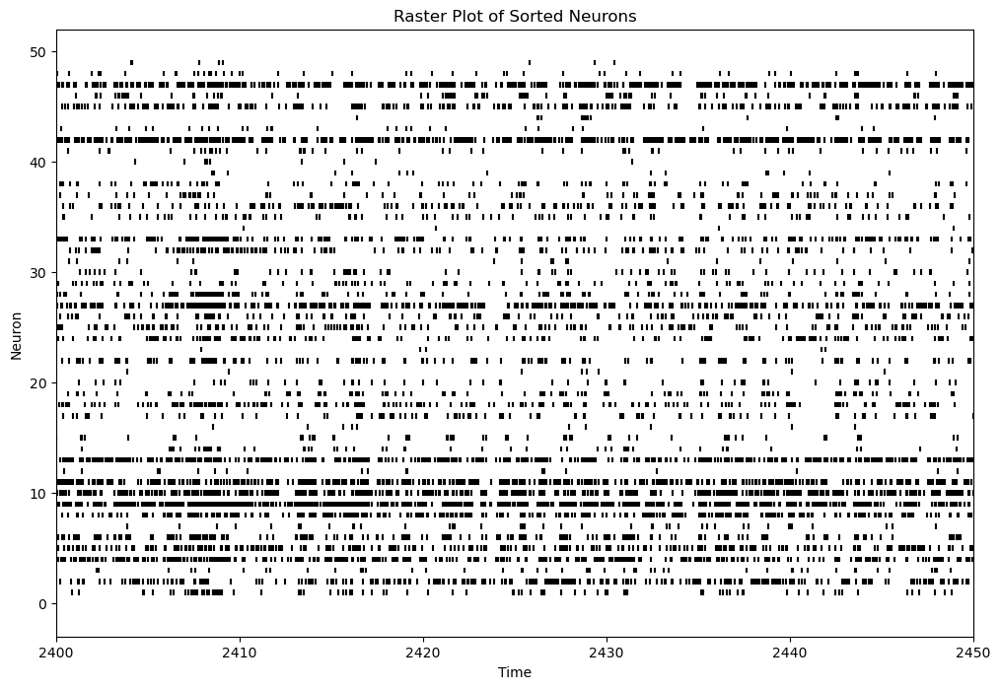

In [5]:
### RASTER PLOT OF THE SPIKING ACTIVITY OF THE SORTED NEURONS ###

plt.figure(figsize=(12, 8))
plt.eventplot(neuron_spikes_sorted[:50], colors='black', linelengths=0.5)
plt.xlabel('Time')
plt.ylabel('Neuron')
plt.xlim(2400, 2450)
plt.title('Raster Plot of Sorted Neurons')
plt.savefig(f'{process_folder}/' + "raster_plot.jpg", dpi=300, bbox_inches='tight')
plt.show()


In [6]:
### FUNCTION: DISCRETIZED TARGET POSITION FROM CENTIMETERS TO GRIDS ###

# 8X8 GRID

def discretizza_griglia(X_coord,Y_coord):
    uniq_X=np.unique(X_coord)                   # take the single value although it appears multiple times and sorts the values in ascending order
    uniq_Y=np.unique(Y_coord)
    step_X=np.mean(np.diff(uniq_X))             # compute the difference of contiguous elements and then the mean of the differences to obtain the center 
    step_Y=np.mean(np.diff(uniq_Y))             ##! dato che potrebbero essere non equispaziati (anche se in realtà lo sono) così da avere il centro. 

    edges_X = np.concatenate([uniq_X - step_X / 2, [uniq_X[-1] + step_X / 2]])  # prendo il punto centrale tra il valore precedente e successivo mezzi?
    edges_Y = np.concatenate([uniq_Y - step_Y / 2, [uniq_Y[-1] + step_Y / 2]])

    digi_X=np.digitize(X_coord,edges_X)-1
    digi_Y=np.digitize(Y_coord,edges_Y)-1
    return digi_Y+digi_X*(len(uniq_Y))     # Y ha importanza meno significativa ( quindi cambiando di 1 la X ti fa saltare di Len(Y) il val discreto)


#--------------------------------------------------------#
# 2X2 GRID

def discretizza_griglia_2x2(X_coord,Y_coord):
    uniq_X=np.unique(X_coord)                   # take the single value although it appears multiple times and sorts the values in ascending order
    uniq_Y=np.unique(Y_coord)
    step_X=np.mean(np.diff(uniq_X))             # compute the difference of contiguous elements and then the mean of the differences to obtain the center 
    step_Y=np.mean(np.diff(uniq_Y))             ##! dato che potrebbero essere non equispaziati (anche se in realtà lo sono) così da avere il centro. 

    edges_X = np.concatenate([uniq_X - step_X / 2, [uniq_X[-1] + step_X / 2]])  # prendo il punto centrale tra il valore precedente e successivo mezzi?
    edges_Y = np.concatenate([uniq_Y - step_Y / 2, [uniq_Y[-1] + step_Y / 2]])
    new_edges_X = np.concatenate([uniq_X - step_X / 2, [uniq_X[-1] + step_X / 2]])[::4]  # prendo il punto centrale tra il valore precedente e successivo mezzi?
    new_edges_Y = np.concatenate([uniq_Y - step_Y / 2, [uniq_Y[-1] + step_Y / 2]])[::4]

    digi_X=np.digitize(X_coord,new_edges_X)-1
    digi_Y=np.digitize(Y_coord,new_edges_Y)-1

    return digi_Y+digi_X*(len(new_edges_Y)-1)     # Y ha importanza meno significativa ( quindi cambiando di 1 la X ti fa saltare di Len(Y) il val discreto)



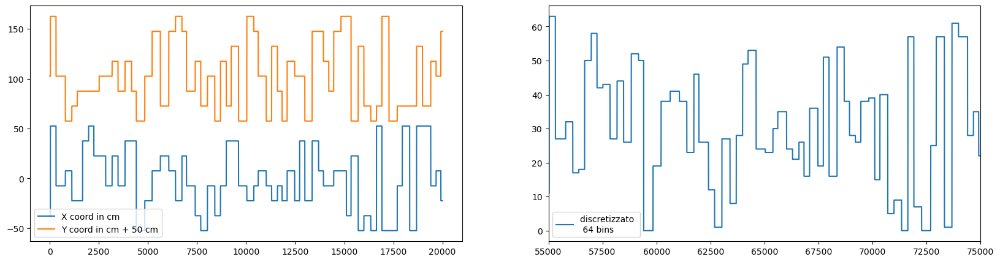

(101501, 2) [-52.5 -37.5 -22.5  -7.5   7.5  22.5  37.5  52.5]
(101501,) [ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 61 62 63]


In [7]:
### RUN E PLOT 8X8 GRID ###  

target_discr_or=discretizza_griglia(target_pos_or[:,0],target_pos_or[:,1])

plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
plt.plot(target_pos_or[55000:75000, 0], label='X coord in cm')
plt.plot(target_pos_or[55000:75000, 1] + 50, label='Y coord in cm + 50 cm')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(target_discr_or, label="discretizzato \n 64 bins")
plt.xlim([55000, 75000])
plt.legend()
plt.savefig(f'{process_folder}/' + "target_8x8.jpg", dpi=300, bbox_inches='tight')

plt.show()

print(target_pos_or.shape, np.unique(target_pos_or[:,0])) 
print(target_discr_or.shape, np.unique(target_discr_or)) 

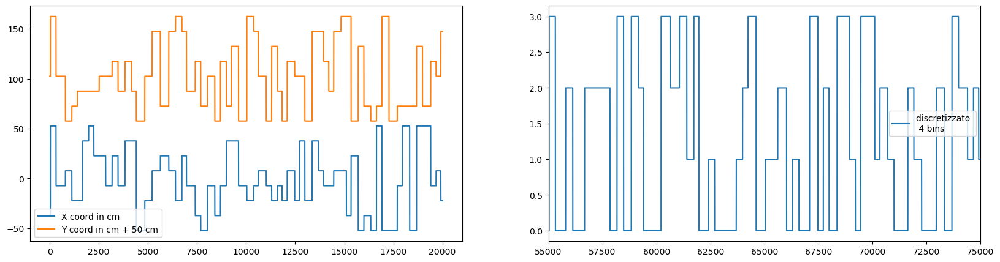

(101501,) [0 1 2 3]


In [8]:
### RUN E PLOT 2X2 GRID ###

target_discr_or_2x2=discretizza_griglia_2x2(target_pos_or[:,0],target_pos_or[:,1])


plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
plt.plot(target_pos_or[55000:75000, 0], label='X coord in cm')
plt.plot(target_pos_or[55000:75000, 1] + 50, label='Y coord in cm + 50 cm')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(target_discr_or_2x2, label="discretizzato \n 4 bins")
plt.xlim([55000, 75000])
plt.legend()
plt.savefig(f'{process_folder}/' + "target_2x2.jpg", dpi=300, bbox_inches='tight')
plt.show()

print(target_discr_or_2x2.shape, np.unique(target_discr_or_2x2)) 

In [9]:
### FUNTION TO REDUCE THE SAMPLING FREQUENCY OF THE SIGNALS FOR COMPUTATIONAL POWER REASONS ###
def decimate_signal(signal, original_rate, target_rate):
    """
    Resample a signal from the original sampling rate to the target sampling rate.

    Parameters:
    - signal: The input signal, a NumPy array with shape (num_samples, num_channels).
    - original_rate: The original sampling rate of the signal.
    - target_rate: The target sampling rate.

    Returns:
    - resampled_signal: The resampled signal.
    """

    # Calculate the resampling factor
    resampling_factor = int(np.round(original_rate / target_rate))

    # Calculate the new number of samples
    if len(signal.shape) == 2:
        resampled_signal = signal[::resampling_factor, :]
    else:
        resampled_signal = signal[::resampling_factor]
    return resampled_signal

# we do not use the resampling function like fast fourier to avoid aliasing in the function

In [10]:
### SUBSAMPLING KINEMATIC

original_sampling_rate = 250  # Hz
target_sampling_rate = 25  # Hz

target_discr_or = decimate_signal(target_discr_or,original_sampling_rate,target_sampling_rate)
target_discr_or_2x2=decimate_signal(target_discr_or_2x2,original_sampling_rate,target_sampling_rate)
print(target_discr_or.shape, target_discr_or_2x2.shape)

(10151,) (10151,)


In [11]:
### SECTION FOR BINNING AND SMOOTHING THE SPIKING ACTIVITY ### 

target_sampling_rate = 25  # Hz
kernel_SD = 0.05                                           # Standard deviation of the gaussian kernel in seconds
bin_size = 1/target_sampling_rate                          # 0.04 [s]
kernel_hl = int(np.ceil(3 * kernel_SD / bin_size))         # half length of the kernel in bins
bin_edges = np.arange(start=np.min(t_points), stop=np.max(t_points), step=bin_size)
n_bins = bin_edges.size - 1

# Create the kernel
kernel_range = np.arange(-kernel_hl * bin_size, kernel_hl * bin_size + bin_size, bin_size)
kernel = norm.pdf(kernel_range, loc=0, scale=kernel_SD)

firing_rates = np.zeros((n_neurons, n_bins))
firing_rates_sorted = np.zeros((n_neurons_sorted, n_bins))

smoothed_firing_rates = np.zeros((n_neurons, n_bins))
smoothed_firing_rates_sorted = np.zeros((n_neurons_sorted, n_bins))

# below not interested problably because we use only the sorted ones
for i in range(n_neurons):
    result = binned_statistic(x=neuron_spikes[i], values=neuron_spikes[i], statistic="count", bins=bin_edges)
    firing_rates[i, :] = result.statistic

    # Convolve the kernel with ones
    nm = np.convolve(kernel, np.ones_like(firing_rates[i, :]), mode='full')

    # Convolve the kernel with spike_counts
    aux_smoothed_FR = np.convolve(kernel, firing_rates[i, :], mode='full') / nm

    # Cut off the edges
    smoothed_firing_rates[i, :]  = aux_smoothed_FR[kernel_hl : -kernel_hl]


#important part we will use 

for i in range(n_neurons_sorted):   
    result_sorted = binned_statistic(x=neuron_spikes_sorted[i], values=neuron_spikes_sorted[i], statistic="count", bins=bin_edges)
    firing_rates_sorted[i, :] = result_sorted.statistic
    # Convolve the kernel with ones
    nm = np.convolve(kernel, np.ones_like(firing_rates_sorted[i, :]), mode='full')  # double check why use this: normalization? why if the results are not normalized between 0 and 1??? ask Chiara 
    # Convolve the kernel with spike_counts
    aux_smoothed_FR = np.convolve(kernel, firing_rates_sorted[i, :], mode='full') / nm

    # Cut off the edges
    smoothed_firing_rates_sorted[i, :]  = aux_smoothed_FR[kernel_hl : -kernel_hl]
    
firing_rates = firing_rates.T
firing_rates_sorted = firing_rates_sorted.T
smoothed_firing_rates = smoothed_firing_rates.T
smoothed_firing_rates_sorted = smoothed_firing_rates_sorted.T
print(len(smoothed_firing_rates),smoothed_firing_rates_sorted.shape)

bin_smooth_suffix=f"_bin{bin_size}_kernel{kernel_SD}"                           # if you want to add information in data and plots

10149 (10149, 173)


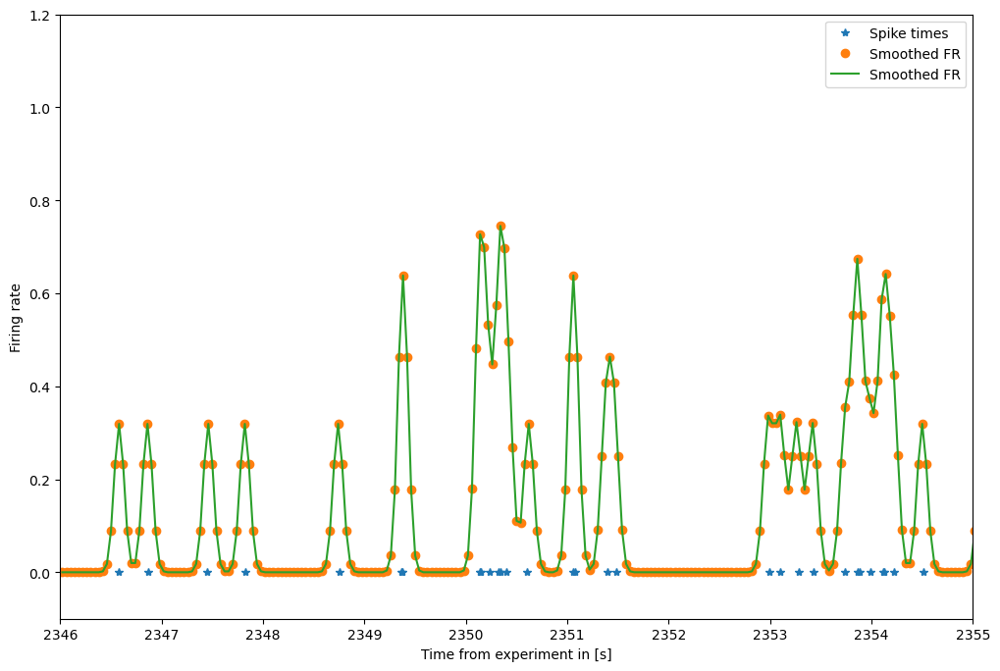

In [12]:
### PLOT THE SMOOTHED FIRING RATES AND SPIKE TIMING ###
%matplotlib inline

original_time_spikes = bin_edges[:-1]+np.diff(bin_edges)/2 # time points for the smoothed firing rates
neuron_number = 6                                          # neuron to plot, change it to see the other neurons how they behave  
fig = plt.figure(figsize=(12, 8))
plt.plot(neuron_spikes_sorted[:][neuron_number],np.zeros_like(neuron_spikes_sorted[:][neuron_number]),'*', label='Spike times')
plt.plot(original_time_spikes, smoothed_firing_rates_sorted[:,neuron_number], "o", label='Smoothed FR')
plt.plot(original_time_spikes, smoothed_firing_rates_sorted[:,neuron_number], label='Smoothed FR')
plt.xlim(2346,2355)
plt.ylim(-0.1,1.2)
plt.xlabel('Time from experiment in [s]')
plt.ylabel('Firing rate')
plt.legend()
plt.savefig(f'{process_folder}/' + "smoothed_firing_and_original_spike_timing.jpg", dpi=300, bbox_inches='tight')
plt.show()

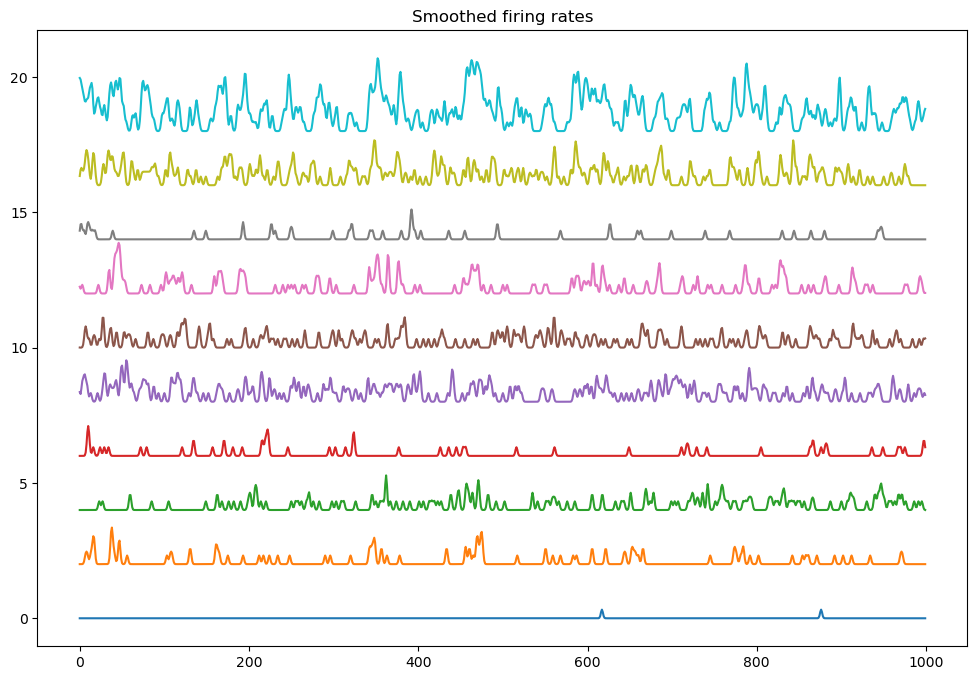

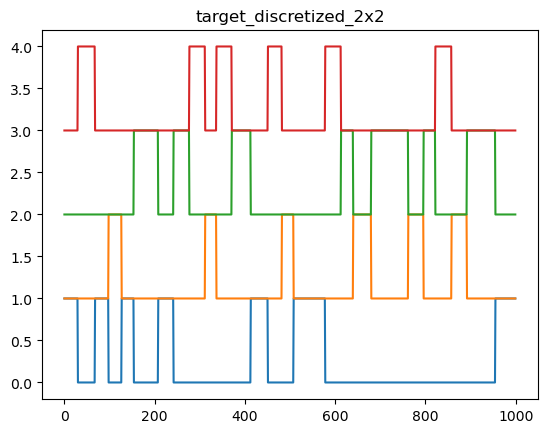

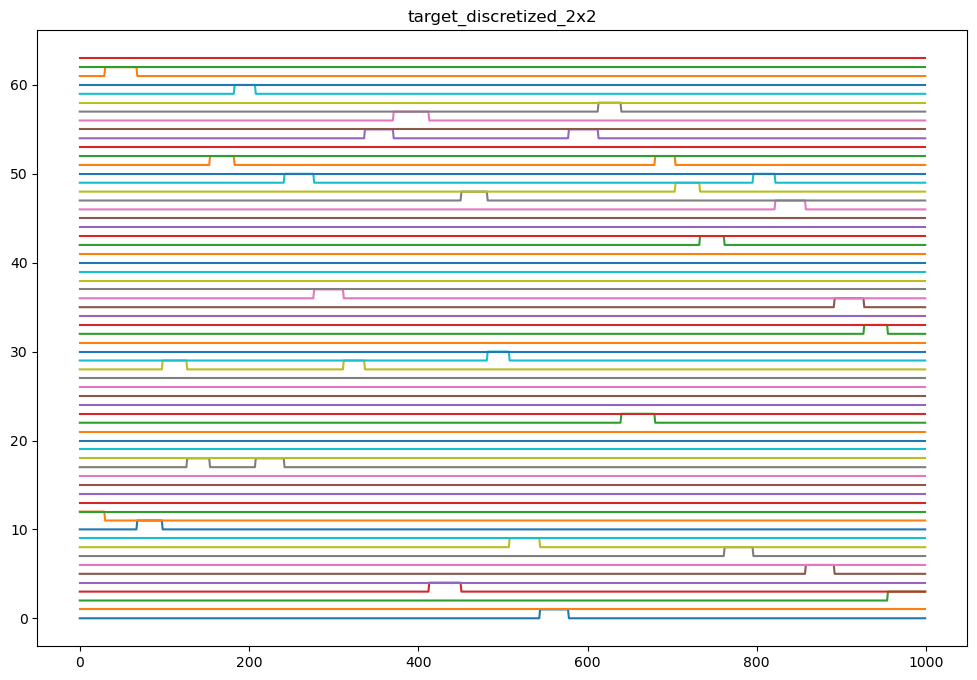

(9799, 173) (9799,)


In [13]:
### FURTHER CLEANING AD HOC FOR DATASET, MATCHING TIME POINTS ETC ###
%matplotlib inline

# remove the first 350 time bins because of inactivity
neu_act = smoothed_firing_rates_sorted[350:] 

# plot to check the neural activity
plt.figure(figsize=(12, 8))
for i in range(10):
    plt.plot(neu_act[:1000,i]+i*2)
plt.title("Smoothed firing rates")
plt.savefig(f'{process_folder}/' + "smoothed_firing_examples.jpg", dpi=300, bbox_inches='tight')
plt.show()

# matching target to the length of the neural activity
target_2x2=target_discr_or_2x2[350:-2]   
target_8x8=target_discr_or[350:-2]  

#plot to check the target 2x2 discretized
for i in range(target_2x2.max()+1): 
    plt.plot((target_2x2[:1000]==i)+i)
plt.title("target_discretized_2x2")
plt.savefig(f'{process_folder}/' + "target_2x2_examples.jpg", dpi=300, bbox_inches='tight')
plt.show()

#plot to check the target 8x8 discretized
plt.figure(figsize=(12, 8))
for i in range(target_8x8.max()+1): 
    plt.plot((target_8x8[:1000]==i)+i)
plt.title("target_discretized_2x2")
plt.savefig(f'{process_folder}/' + "target_2x2_examples.jpg", dpi=300, bbox_inches='tight')
plt.show()

print(neu_act.shape, target_2x2.shape)

In [14]:
### FUNCTION: TIME DELAY EMBEDDING (TDE) ###  COMMENT WITH ''' ''' AND USE LATER TO CHECK THE DIFFRENCE

def time_embedding(neu_act, tau, m):            # embed the neural activity in the time delay embedding space
    time_points, n_neurons = neu_act.shape
    embedded_neu_act = np.zeros((time_points - (m)*tau, n_neurons * (m+1)))
    print(embedded_neu_act.shape)
    for i in range(m+1):
        print(i*n_neurons,(i+1)*n_neurons)
        embedded_neu_act[:, i*n_neurons:(i+1)*n_neurons] = neu_act[i*tau:time_points-((m-i)*tau), :]
    
    return embedded_neu_act

def shift_TDE_for_target(target, tau, m):       # remove the same point are removed from the original data aligned with the original time series
    return target[m*tau:]


In [15]:
### TIME DELAY EMBEDDING (TDE) DATA ### 
#if you want to plot the mean trajectory, m*tau must be stricltly less than 9
'''
#to avoid overwriting the original data
neu_act = smoothed_firing_rates_sorted[350:] 
target_2x2=target_discr_or_2x2[350:-2]

# declare the paramerters for the time delay embedding and run it 
tau = 3                      # time lag
m = 2                        # number of time lags -1 (m=2 you have an extra time series for each neuron in addition to the original one)
embedded_neu_act = time_embedding(neu_act, tau, m)

### target reshaping ### 
target_2x2_tEMB = shift_TDE_for_target(target_2x2, tau, m) 
print(f"embedded_neu_act shape {embedded_neu_act.shape} and target_2x2 shape {target_2x2_tEMB.shape}")
'''

'\n#to avoid overwriting the original data\nneu_act = smoothed_firing_rates_sorted[350:] \ntarget_2x2=target_discr_or_2x2[350:-2]\n\n# declare the paramerters for the time delay embedding and run it \ntau = 3                      # time lag\nm = 2                        # number of time lags -1 (m=2 you have an extra time series for each neuron in addition to the original one)\nembedded_neu_act = time_embedding(neu_act, tau, m)\n\n### target reshaping ### \ntarget_2x2_tEMB = shift_TDE_for_target(target_2x2, tau, m) \nprint(f"embedded_neu_act shape {embedded_neu_act.shape} and target_2x2 shape {target_2x2_tEMB.shape}")\n'

In [16]:
### PLOT FOR TDE, SMOOTHED FIRING RATES AND SPIKE TIMING SHIFTED IN TIME ###
'''
%matplotlib inline

length_neurons = neu_act.shape[1]
offset_raw_spikes = bin_size*tau*(m) # each time
offset_processed_spikes = tau*(m)
print(offset_raw_spikes)
original_time_spikes = bin_edges[:-1]+np.diff(bin_edges)/2
neuron_number = 6
fig = plt.figure(figsize=(12, 8))
plt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number], "o-", label='Smoothed FR')
plt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number+length_neurons], "^-", label='Delayed 1 FR')
#plt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number+length_neurons*2], "^-", label='Delayed 2 FR')
plt.plot(neuron_spikes_sorted[:][neuron_number]+offset_raw_spikes,np.zeros_like(neuron_spikes_sorted[:][neuron_number]+offset_raw_spikes),'*', markersize=8, label='Spike times')
plt.xlim(2369,2375)
plt.ylim(-0.1,1.5)
plt.xlabel('Time from experiment in [s]')
plt.ylabel('Firing rate')
plt.title(f"Spike timeing and smoothed firing rates with time delay embedding m={m} and tau={tau} n°{neuron_number}")
plt.legend()
plt.show()
'''

'\n%matplotlib inline\n\nlength_neurons = neu_act.shape[1]\noffset_raw_spikes = bin_size*tau*(m) # each time\noffset_processed_spikes = tau*(m)\nprint(offset_raw_spikes)\noriginal_time_spikes = bin_edges[:-1]+np.diff(bin_edges)/2\nneuron_number = 6\nfig = plt.figure(figsize=(12, 8))\nplt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number], "o-", label=\'Smoothed FR\')\nplt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number+length_neurons], "^-", label=\'Delayed 1 FR\')\n#plt.plot(original_time_spikes[350+offset_processed_spikes:], embedded_neu_act[:,neuron_number+length_neurons*2], "^-", label=\'Delayed 2 FR\')\nplt.plot(neuron_spikes_sorted[:][neuron_number]+offset_raw_spikes,np.zeros_like(neuron_spikes_sorted[:][neuron_number]+offset_raw_spikes),\'*\', markersize=8, label=\'Spike times\')\nplt.xlim(2369,2375)\nplt.ylim(-0.1,1.5)\nplt.xlabel(\'Time from experiment in [s]\')\nplt.ylabel(\'Firing rate\')\nplt.

In [17]:
### VARIABLES DECLARATION AND STRUCTURE SAVING FOR TDE ###  COMMENT WITH ''' ''' AND USE LATER TO CHECK THE DIFFRENCE
'''
# Variables declaration 
n_neur = neu_act.shape[1] # Number of neurons
n_input = len(np.unique(target_2x2))  # Number of binned input from the screen task 
t_plot = neu_act.shape[0]  # Number of time points to plot from the test set
n_dim = 3  # Number of dimensions for the dimensionality reduction. 3 to visualize in 3D

# Variables for plots
color_map = plt.cm.get_cmap('jet', n_input) # Color map for the plots
size_dots = 5  # Size of the dots in the plots
list_names_quadrants = ['bott_left', 'top_left', 'bott_right', 'top_right']

# strings for the plots and files
name_file = f"DimRed_array"
TDE_suffix=f"_tau{tau}_m{m}"
suffix_neurons_time = f"neurons{n_neur}_time{t_plot}"   # suff_neu_t
suffix_info = TDE_suffix + suffix_neurons_time # add if missing something 
file_ext = '.jpg'
print(n_neur, n_input, t_plot,  n_dim) 

### STRUCTURE SAVING RESULTS ###
pre_results_folder = "results_dim_reduction_delay_embedding"
if not os.path.exists(pre_results_folder):
    os.makedirs(pre_results_folder)

result_folder = os.path.join(pre_results_folder, f"TDE{TDE_suffix}")
if not os.path.exists(result_folder):
    os.makedirs(result_folder)
'''

'\n# Variables declaration \nn_neur = neu_act.shape[1] # Number of neurons\nn_input = len(np.unique(target_2x2))  # Number of binned input from the screen task \nt_plot = neu_act.shape[0]  # Number of time points to plot from the test set\nn_dim = 3  # Number of dimensions for the dimensionality reduction. 3 to visualize in 3D\n\n# Variables for plots\ncolor_map = plt.cm.get_cmap(\'jet\', n_input) # Color map for the plots\nsize_dots = 5  # Size of the dots in the plots\nlist_names_quadrants = [\'bott_left\', \'top_left\', \'bott_right\', \'top_right\']\n\n# strings for the plots and files\nname_file = f"DimRed_array"\nTDE_suffix=f"_tau{tau}_m{m}"\nsuffix_neurons_time = f"neurons{n_neur}_time{t_plot}"   # suff_neu_t\nsuffix_info = TDE_suffix + suffix_neurons_time # add if missing something \nfile_ext = \'.jpg\'\nprint(n_neur, n_input, t_plot,  n_dim) \n\n### STRUCTURE SAVING RESULTS ###\npre_results_folder = "results_dim_reduction_delay_embedding"\nif not os.path.exists(pre_results_fol

In [18]:
### VARIABLES DECLARATION FOR NON TDE ###  COMMENT WITH ''' ''' WHEN USING TDE

# Variables declaration 
n_neur = neu_act.shape[1] # Number of neurons
n_input = len(np.unique(target_2x2))  # Number of binned input from the screen task 
t_plot = neu_act.shape[0]  # Number of time points to plot from the test set
n_dim = 3  # Number of dimensions for the dimensionality reduction. 3 to visualize in 3D

# Variables for plots
color_map = plt.cm.get_cmap('jet', n_input) # Color map for the plots
size_dots = 5  # Size of the dots in the plots
list_names_quadrants = ['bott_left', 'top_left', 'bott_right', 'top_right']

# strings for the plots and files
name_file = f"DimRed_array"
suffix_neurons_time = f"neurons{n_neur}_time{t_plot}"   # suff_neu_t
suffix_info = suffix_neurons_time # add if missing something 
file_ext = '.jpg'
print(n_neur, n_input, t_plot,  n_dim) 

### STRUCTURE SAVING RESULTS ###
result_folder = "results_dim_reduction"
if not os.path.exists(result_folder):
    os.makedirs(result_folder)


173 4 9799 3


## FUNCTION SECTION FOR PLOTS AND DIMRED

In [19]:
### FUNCTION: LOAD DIMRED TIME SERIES NO PARAMETERS ###
def load_dimred_ts(dimred_type, folder, name_file=name_file, suffix_info=suffix_info):
    '''
    Description: This function loads the time series from the dimensionality reduction.
    input:
    - dimred_type: string with the type of dimensionality reduction
    - folder: string with the folder where the results are saved
    - file_path: string with the path to the file
    output:
    - X_dimred: array with the time series from the dimensionality reduction
    '''
    file_path = os.path.join(folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
    data = np.load(file_path)
    X_dimred = data['arr']
    
    return X_dimred

In [20]:
### FUNTION: LOADING SINGLE PARAMETER ISOMAP DIMRED ARRAY ### 

def load_single_param_dimred(folder, dimred_type, params_name, num_neighb, suffix_info=suffix_info, name_file=name_file):
    ''' 
    '''
    file_path = os.path.join(folder, f"{name_file}_{dimred_type}_{params_name}={num_neighb}_{suffix_info}.npz")
    dimred_loaded = np.load(file_path)['arr']

    return dimred_loaded

In [21]:
### FUNCTION: LOADING DIMRED ARRAY MULTIPLE PARAMETERS ### 

def load_multi_param_dimred(folder, dimred_type, params_list, params_name, suffix_info=suffix_info, name_file=name_file):
    ''' 
    '''
    dimred_loaded = []
    for i in range(len(params_list)):
        file_path = os.path.join(folder, f"{name_file}_{dimred_type}_{params_name}={params_list[i]}_{suffix_info}.npz")
        dimred_loaded.append(np.load(file_path)['arr'])

    return dimred_loaded

In [22]:
### FUNCTION PLOTS SINGLE ANGLE 3D PLOTS AND SAVE THEM###

# function to plot the 3D dimensionality reduction time series with default angle having the loaded dimred data and the target and save them in the right folder
def plots_3D_fix_angle(dim_red_tseries, target_2x2, dimred_type, name_plot, folder, list_names_quadrants=list_names_quadrants, color_map=color_map, size_dots=size_dots):
    fig = plt.figure(figsize=(20, 15))
    ax = fig.add_subplot(111, projection='3d')
    for i in range(n_input):
        ax.scatter(dim_red_tseries[np.where(target_2x2== i)[0],0], dim_red_tseries[np.where(target_2x2== i)[0],1], dim_red_tseries[np.where(target_2x2== i)[0],2], color=color_map(i),label=f"quadrant {list_names_quadrants[i]}", s=size_dots)
    ax.set_xlabel('Component 1')
    ax.set_ylabel('Component 2')
    ax.set_zlabel('Component 3')
    ax.set_title(f'3D {dimred_type} Plot')
    plt.legend()
    plt.savefig(f'{folder}/' + name_plot, dpi=300, bbox_inches='tight')
    plt.show()

In [23]:
### FUNCTION PLOTS MULTIPLE ANGLES 3D PLOTS AND SAVE THEM###
# function to plot the 3D dimensionality reduction time series with different angles having the loaded dimred data and the target and save them in the right folder

def plots_3D_multiple_angles(dim_red_tseries, target_2x2_tEMB, dimred_type, name_plot, folder, list_names_quadrants=list_names_quadrants, color_map=color_map):
    
    # Set the angles for each subplot
    angles = [(30, 45), (30, 135), (30, 225), (30, 315),
          (120, 45), (120, 135), (120, 225), (120, 315),
          (210, 45), (210, 135), (210, 225), (210, 315),
          (300, 45), (300, 135), (300, 225), (300, 315)]

    fig, axs = plt.subplots(4, 4, figsize=(15, 15), subplot_kw={'projection': '3d'})
    
    for j, ax in enumerate(axs.flat):
        ax.view_init(elev=angles[j][0], azim=angles[j][1])
        for i in range(n_input):
            ax.scatter(dim_red_tseries[np.where(target_2x2_tEMB== i)[0],0], dim_red_tseries[np.where(target_2x2_tEMB== i)[0],1], dim_red_tseries[np.where(target_2x2_tEMB== i)[0],2], color=color_map(i), label=f"quadrant {list_names_quadrants[i]}", s=size_dots)
    
        ax.set_xlabel('Component 1')
        ax.set_ylabel('Component 2')
        ax.set_zlabel('Component 3')
        ax.set_title(f'Angle: {angles[j]}')
    
    plt.legend()
    plt.tight_layout()
    fig.suptitle(f'3D {dimred_type} Plot', fontsize=20)
    plt.savefig(f'{folder}/' + name_plot, dpi=100, bbox_inches='tight')
    plt.show()

# other option angles #

#    angles = [(30, 45), (30, 165), (30, 285),
#              (150, 45), (150, 165), (150, 285),
#              (270, 45), (270, 165), (270, 285)]

In [24]:
### FUNCTION: 3D PLOT MULTIPLE PARAMETERS FIX ANGLE ### #TODO: np.ceil() to give the add_subplot the right number of subplots

def plots_3D_fix_angle_multi_param(dimred_loaded, target_2x2, dimred_type, name_plot, folder, params_list, params_name, list_names_quadrants=list_names_quadrants, color_map=color_map, size_dots=size_dots):
    ''' 
    '''


    fig = plt.figure(figsize=(10, 10))
    for j in range(len(dimred_loaded)):
        ax = fig.add_subplot(2, 2, j+1, projection='3d')
        X_isomap_loaded = dimred_loaded[j]

        for i in range(n_input):
            ax.scatter(X_isomap_loaded[np.where(target_2x2== i)[0], 0], X_isomap_loaded[np.where(target_2x2== i)[0], 1], X_isomap_loaded[np.where(target_2x2== i)[0], 2], color=color_map(i),label=f"quadrant {list_names_quadrants[i]}", s=3)

        ax.set_xlabel('Component 1')
        ax.set_ylabel('Component 2')
        ax.set_zlabel('Component 3')
        ax.set_title(f'{dimred_type} Projection, {params_name} = {params_list[j]}')
    plt.legend()
    plt.savefig(f'{folder}/' + name_plot, dpi=300, bbox_inches='tight')
    plt.show()



In [32]:
### FUNCTION 3D PLOTS INTERACTIVE 3D AND SAVE THEM###

# function to plot the 3D dimensionality reduction time series in an interactive view, having the loaded dimred data and the target and save them in the right folder
# remember to write before any command       %matplotlib widget

def plots_3D_interactive(dim_red_tseries, target_2x2_tEMB, dimred_type, list_names_quadrants=list_names_quadrants, color_map=color_map, size_dots=size_dots):
    # 3D plot PCA components
    fig = plt.figure(figsize=(10, 6))
    ax = Axes3D(fig)
    fig.add_axes(ax)
    for i in range(n_input):
        ax.scatter(dim_red_tseries[np.where(target_2x2_tEMB== i)[0],0], dim_red_tseries[np.where(target_2x2_tEMB== i)[0],1], dim_red_tseries[np.where(target_2x2_tEMB== i)[0],2], color=color_map(i),label=f"quadrant {list_names_quadrants[i]}", s=size_dots)

    ax.set_xlabel('Component 1')
    ax.set_ylabel('Component 2')
    ax.set_zlabel('Component 3')
    ax.set_title(f'3D {dimred_type} Plot')
    plt.legend()
    plt.show()


In [33]:
### FUNCTION: 3D PLOT MEAN TRAJECTORY MULTIPLE ANGLES ###


def plots_3D_mean_traj_multiple_angles(collect_all_mean_ts, dimred_type, name_plot, folder, list_names_quadrants, color_map):

    # Set the angles for each subplot
    angles = [(30, 45), (30, 165), (30, 285),
              (150, 45), (150, 165), (150, 285),
              (270, 45), (270, 165), (270, 285)]

    fig, axs = plt.subplots(3, 3, figsize=(15, 15), subplot_kw={'projection': '3d'})
    fig.add_axes(axs)

    for j, ax in enumerate(axs.flat):
        ax.view_init(elev=angles[j][0], azim=angles[j][1])
        for i in range(n_input):
            ax.plot(collect_all_mean_ts[i][:,0], collect_all_mean_ts[i][:,1], collect_all_mean_ts[i][:,2], color=color_map(i),label=f"quadrant {list_names_quadrants[i]}")
            ax.scatter(collect_all_mean_ts[i][0,0], collect_all_mean_ts[i][0,1], collect_all_mean_ts[i][0,2], color=color_map(i), s=50)
            ax.scatter(collect_all_mean_ts[i][-1,0], collect_all_mean_ts[i][-1,1], collect_all_mean_ts[i][-1,2], marker = '^', color=color_map(i), s=50)
        ax.scatter(collect_all_mean_ts[i][0,0], collect_all_mean_ts[i][0,1], collect_all_mean_ts[i][0,2], color=color_map(i), s=50, label=f"start {list_names_quadrants[i]}")
        ax.scatter(collect_all_mean_ts[i][-1,0], collect_all_mean_ts[i][-1,1], collect_all_mean_ts[i][-1,2], marker = '^', color=color_map(i), s=50, label=f"end {list_names_quadrants[i]}")
    
        ax.set_xlabel('Component 1')
        ax.set_ylabel('Component 2')
        ax.set_zlabel('Component 3')
        ax.set_title(f'Angle: {angles[j]}')
    
    plt.legend()
    plt.tight_layout()
    fig.suptitle(f'3D {dimred_type} mean trajectory', fontsize=20)
    plt.savefig(f'{folder}/' + name_plot, dpi=100, bbox_inches='tight')
    plt.show()


## PCA method 

In [34]:
### PCA PARAMETERS AND SAVING### 
pca_folder = os.path.join(result_folder, "PCA_results")
if not os.path.exists(pca_folder):
    os.makedirs(pca_folder)

In [35]:
### PCA - PRINCIPAL COMPONENTS ANALYSIS ###

pca = PCA(n_components=n_dim)  # Specify the number of components you want to keep
X_pca = pca.fit_transform(neu_act) # [:t_plot,:n_neur]  # Fit the PCA model and transform the data

# Save the PCA model
dimred_type = 'PCA'
file_path_PCA = os.path.join(pca_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
np.savez(file_path_PCA, arr=X_pca)

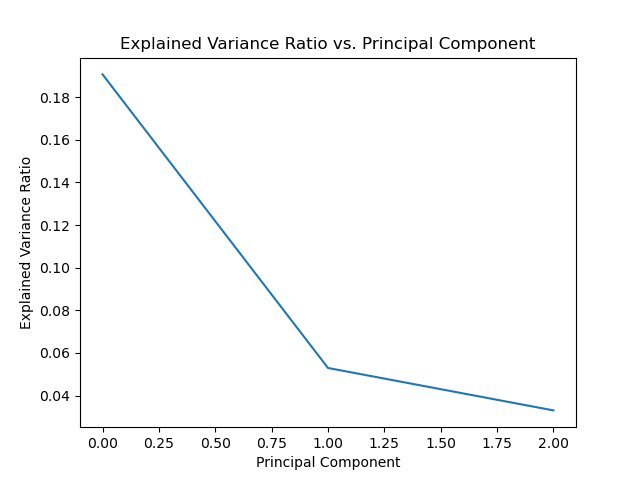

In [36]:
### PLOT THE EXPLAINED VARIANCE RATIO ### ##! DO WE SHOW IT? !##

# Plot the explained variance ratio
plt.figure()
plt.plot(pca.explained_variance_ratio_)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Principal Component')
plt.show()

(9799, 3)


C:\Users\pceo\AppData\Local\Temp\ipykernel_17752\382619708.py:14: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


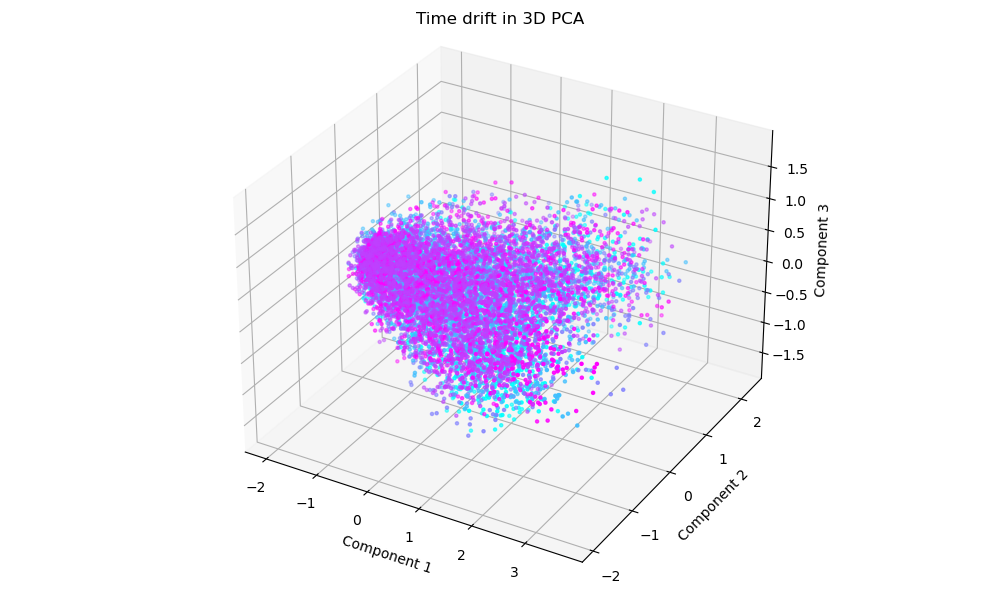

In [37]:
### CHECK TIME DRIFT IN THE PCA - PLOT ###
%matplotlib widget

num_time_color = 5                                                      # number of time intervals to color code  
steps_data_time = int(neu_act.shape[0] // num_time_color)               # number of time points per color interval
time_cmap = plt.cm.get_cmap('cool', num_time_color)                     # color map for the time intervals
time_intervals_c = np.arange(num_time_color)                            # label to check the time intervals in the plot legend 
name_plot = f"3d_{dimred_type}_time_drift_{suffix_info}{file_ext}"      

dimred_loaded = load_dimred_ts(dimred_type, pca_folder)
print(dimred_loaded.shape)
# 3D plot PCA components
fig = plt.figure(figsize=(10, 6))
ax = Axes3D(fig)
fig.add_axes(ax)
for i in range(num_time_color):
    ax.scatter(dimred_loaded[i*steps_data_time:steps_data_time*(i+1),0], dimred_loaded[i*steps_data_time:steps_data_time*(i+1),1], dimred_loaded[i*steps_data_time:steps_data_time*(i+1),2], color=time_cmap(i),label=f"{time_intervals_c[i]*steps_data_time}", s=size_dots)

ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
fig.suptitle('Time drift in 3D PCA')

plt.show()

C:\Users\pceo\AppData\Local\Temp\ipykernel_17752\1679828141.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


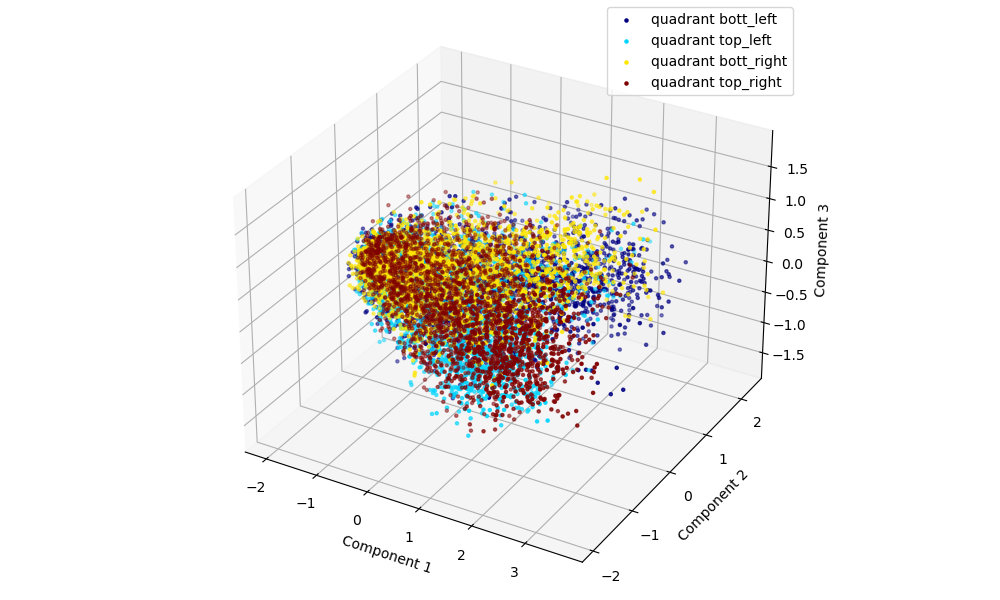

In [38]:
### 3D PLOT PCA FROM FUNCTION - INTERACTIVE ###
%matplotlib widget

# load the PCA data and plot interactive 3D
dimred_loaded = load_dimred_ts(dimred_type, pca_folder)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type)

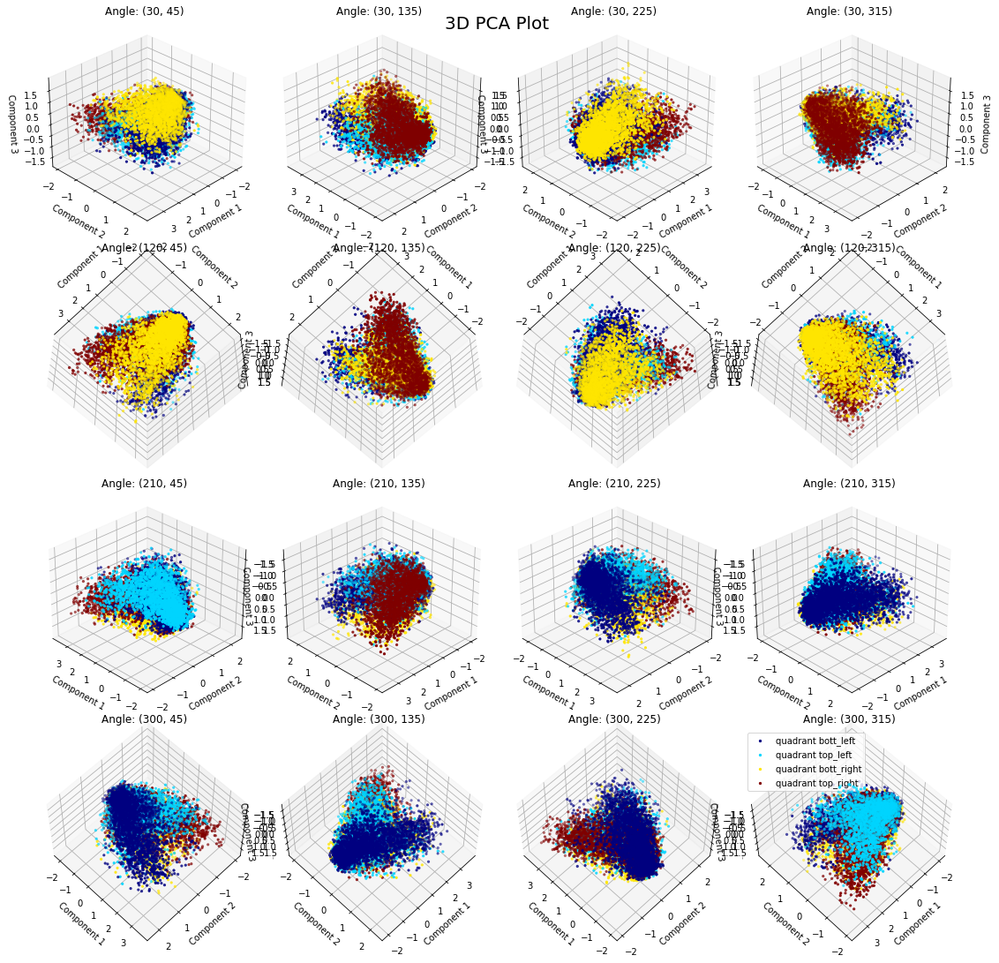

In [33]:
### 3D PLOT PCA FROM FUNCTION - MULTIPLE ANGLES ###
%matplotlib inline

name_plot = f'3D_{dimred_type}_multiple_angles_{suffix_info}{file_ext}'

plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, pca_folder)

### PCA plots consideration
What can you say about the results obtained with PCA? 
- Did you notice some kind of structure in the color coded distribution? 
- Is there a consistent bias in the distribution of data?


## ISOMAP method
!##! TODO: check with the radius results !##

In [162]:
### ISOMAP SAVING FOLDER ### 

ISOMAP_folder = os.path.join(result_folder, "ISOMAP_results")
if not os.path.exists(ISOMAP_folder):
    os.makedirs(ISOMAP_folder)

In [163]:
### ISOMAP NAIVE APPROACH ### 
# n_neighbors and radius are mutually exclusive ###
# estimated execution time = 2 minutes for neighbors = 5

n_neighbors = 5             # Int, default == 5
#radius = 0.1               # Float,  default == None,
n_components = n_dim        # Int default == 2

params_name = 'neighb'
dimred_type = 'ISOMAP'

isomap = Isomap(n_neighbors=n_neighbors, radius=None, n_components=n_components)        # instantiate the Isomap model
X_isomap = isomap.fit_transform(neu_act)
file_path_isomap = os.path.join(ISOMAP_folder, f"{name_file}_{dimred_type}_{params_name}={n_neighbors}_{suffix_info}.npz") # rememeber to change the name when saving for _radius={radius}
np.savez(file_path_isomap, arr=X_isomap)

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


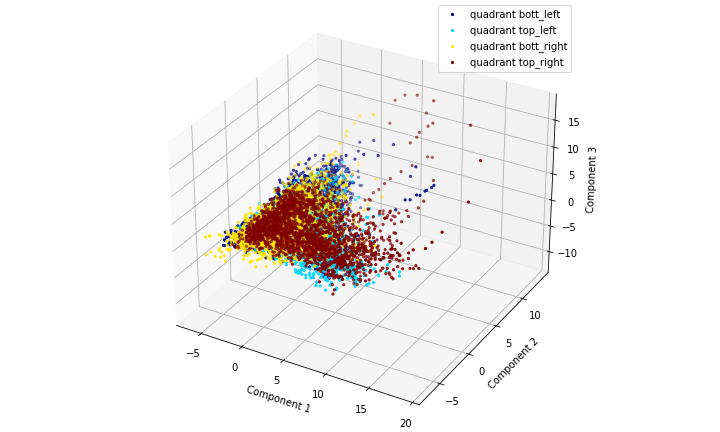

In [164]:
### 3D PLOT ISOMAP FROM FUNCTION - INTERACTIVE ###
%matplotlib widget

# load the ISOMAP data and plot interactive 3D
dimred_loaded = load_single_param_dimred(ISOMAP_folder, dimred_type, params_name, n_neighbors)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type)

In [165]:
### ISOMAP EXECUTION MULTIPLE PARAMETERS ###
# now it is automatized to have a comparison with multiple parameters

list_n_neighbors = [5, 10, 50, 100]
params_name = 'neighb'
dimred_type = 'ISOMAP'

for i in range(len(list_n_neighbors)):    
    isomap = Isomap(n_neighbors=list_n_neighbors[i], radius=None, n_components=n_components)  # Specify the number of components you want to keep
    X_isomap = isomap.fit_transform(neu_act)

    file_path_isomap = os.path.join(ISOMAP_folder, f"{name_file}_{dimred_type}_{params_name}={list_n_neighbors[i]}_{suffix_info}.npz") #_radius={radius}
    np.savez(file_path_isomap, arr=X_isomap)
    print(f"iteration {i} done")



iteration 0 done
iteration 1 done
iteration 2 done
iteration 3 done


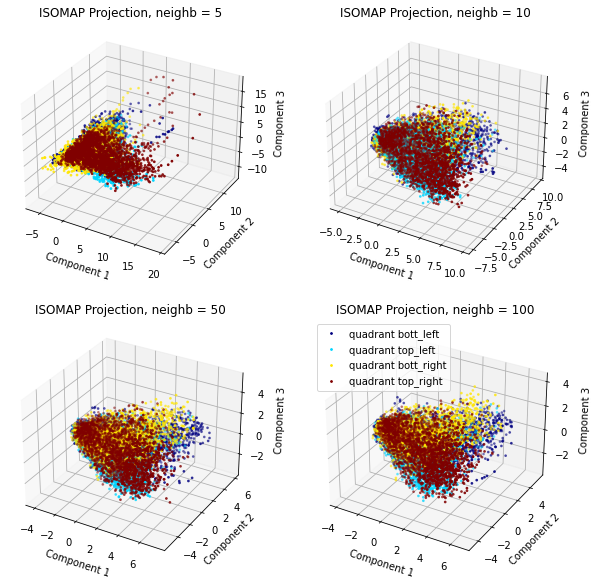

In [166]:
### PLOT MULTIPLE PARAMETERS ISOMAP ###
%matplotlib inline

list_n_neighbors = [5, 10, 50, 100]
dimred_type = 'ISOMAP'
dimred_loaded = load_multi_param_dimred(ISOMAP_folder, dimred_type, list_n_neighbors, params_name)

name_plot = f'3D_plot_{dimred_type}_multiple_negh{list_n_neighbors}_{suffix_info}{file_ext}'
plots_3D_fix_angle_multi_param(dimred_loaded, target_2x2, dimred_type, name_plot, ISOMAP_folder, list_n_neighbors, params_name, list_names_quadrants, color_map, size_dots=size_dots)


C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


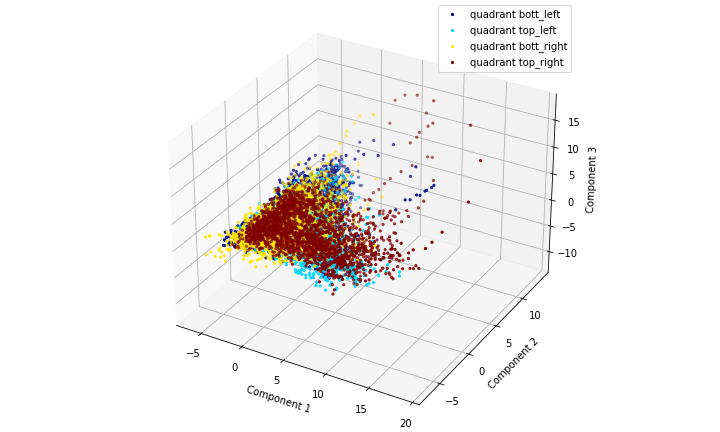

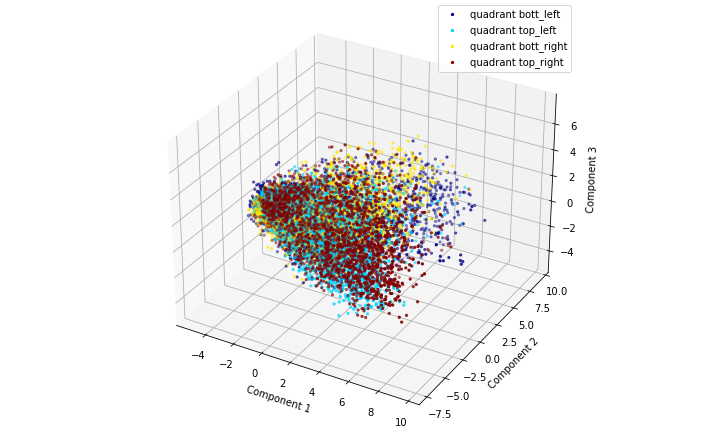

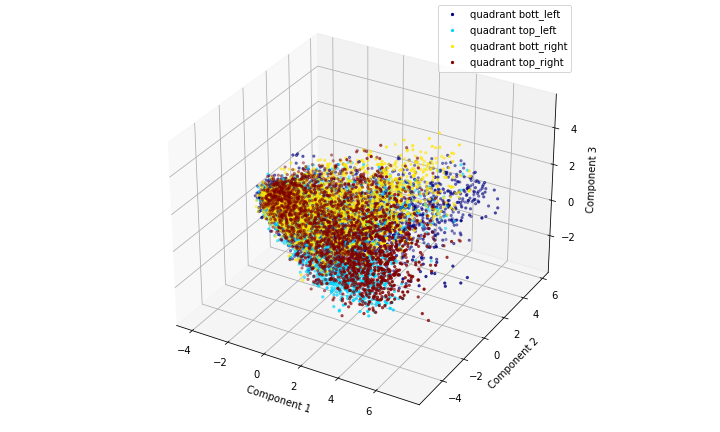

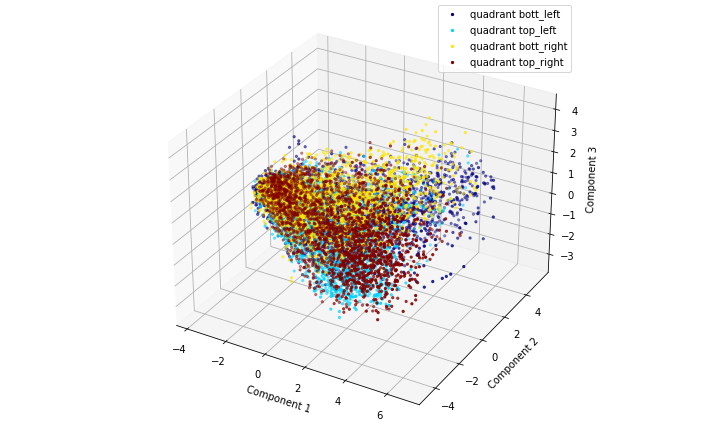

In [167]:
### ### 3D PLOT ISOMAP MULTIPLE PARAMENTERS FROM FUNCTION - INTERACTIVE ###
%matplotlib widget

list_n_neighbors = [5, 10, 50, 100]
dimred_type = 'ISOMAP'
ts_multi_param_list = load_multi_param_dimred(ISOMAP_folder, dimred_type, list_n_neighbors, params_name)

for i in range(len(list_n_neighbors)):
    plots_3D_interactive(ts_multi_param_list[i], target_2x2, dimred_type, list_names_quadrants, color_map, size_dots)

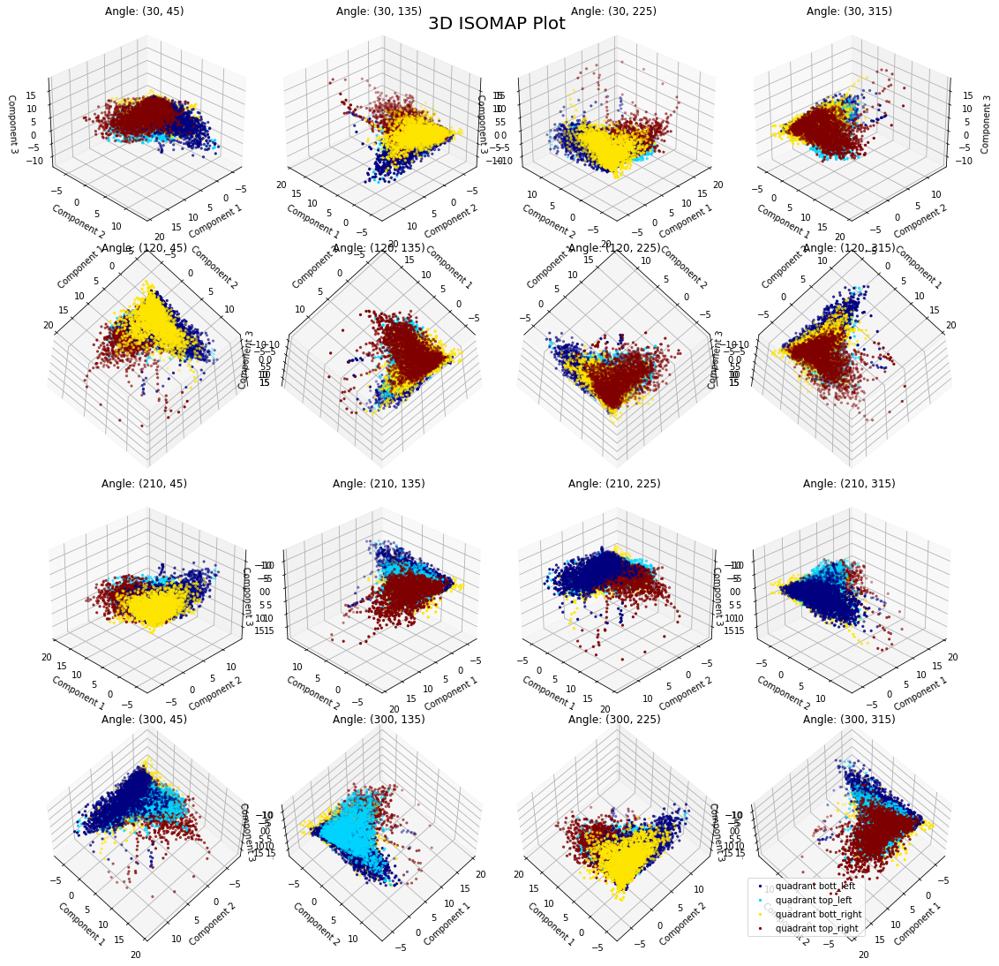

In [168]:
### 3D PLOT ISOMAP - MULTIPLE ANGLES ###
%matplotlib inline

### from isomap remove number of components ###
params_name = 'neighb'
num_neighb = 5
dimred_type = 'ISOMAP'

dimred_loaded = load_single_param_dimred(ISOMAP_folder, dimred_type, params_name, num_neighb)

name_plot = f'3D_plot_{dimred_type}_{params_name}={num_neighb}_multiple_angles_{suffix_info}{file_ext}'
plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, ISOMAP_folder)

## Isomap considerations
- How did the shape of dimensionally reducted neural activity is arranged with ISOMAP?
- How did the number of neighbors influenced the distribution? 
- Can you spot the qualitative threshold in the change of shape wrt to neighbors?


### Tested parameters 
- n_neighbors:

- radius: 



## ICA section 

In [169]:
### ICA PARAMETERS AND SAVING ### 

ICA_folder = os.path.join(result_folder, "ICA_results")
if not os.path.exists(ICA_folder):
    os.makedirs(ICA_folder)

In [170]:
### ICA - INDEPENDENT COMPONENT ANALYSIS ###

n_components = n_dim    # Int, default == 2
dimred_type = 'ICA'

X_ICA,S,W = ica1(neu_act, n_dim)

file_path_ICA = os.path.join(ICA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
np.savez(file_path_ICA, arr=X_ICA)

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


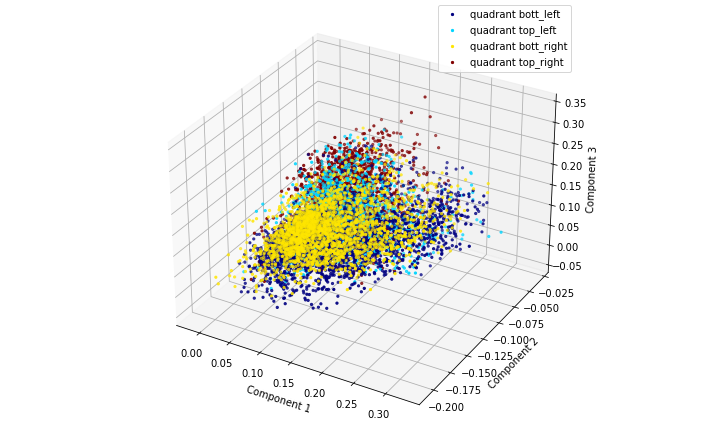

In [171]:
### 3D PLOT ICA FROM FUNCTION - INTERACTIVE ###
%matplotlib widget

# load the ICA data and plot interactive 3D
dimred_loaded = load_dimred_ts(dimred_type, ICA_folder)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type)

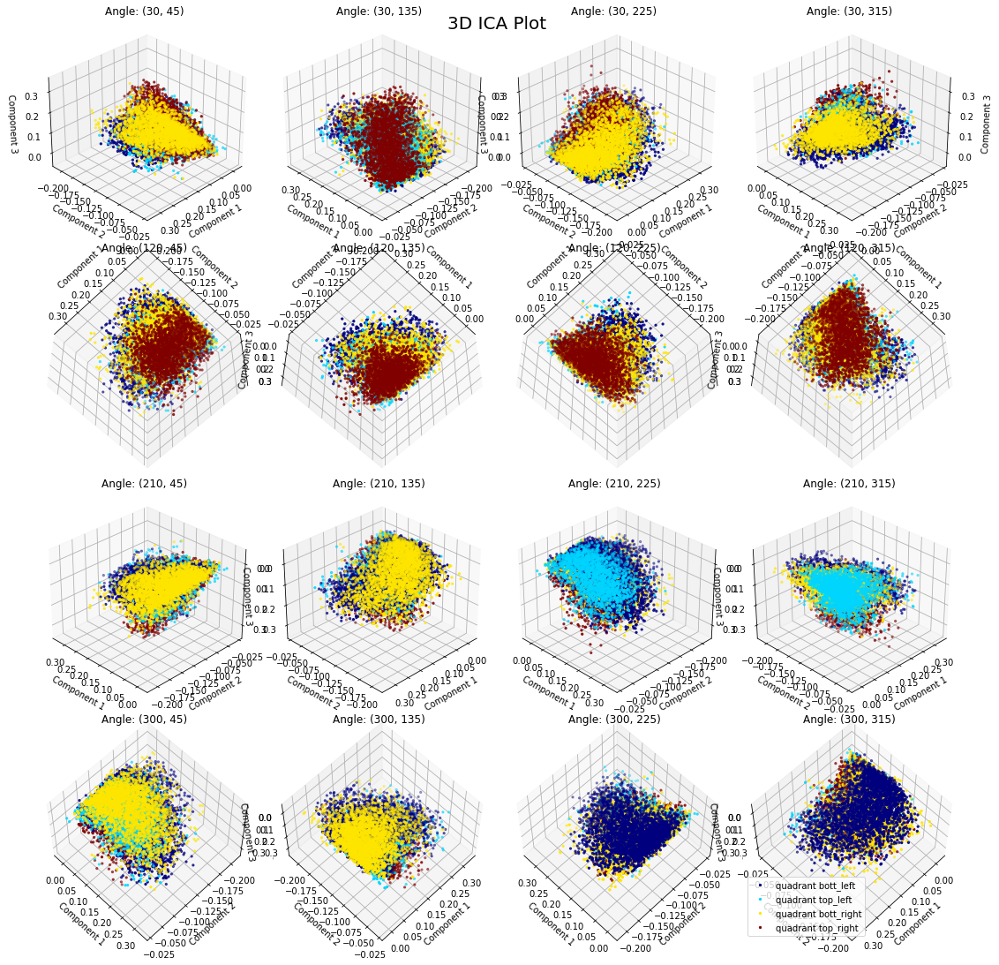

In [172]:
### 3D PLOT ICA FROM FUNCTION - MULTIPLE ANGLES ###
%matplotlib inline

dimred_loaded = load_dimred_ts(dimred_type, ICA_folder)
name_plot = f'3D_{dimred_type}_multiple_angles_{suffix_info}{file_ext}'

plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, ICA_folder)

# ICA consideration

## FACTOR ANALYSIS (FA) SECTION

In [173]:
### FACTOR ANALYSIS PARAMETERS AND SAVING ### 

FA_folder = os.path.join(result_folder, "FA_results")
if not os.path.exists(FA_folder):
    os.makedirs(FA_folder)

In [174]:
### FACTOR ANALYSIS ###

n_components = n_dim        # Int, default == 2
dimred_type = 'FA'

factor_analysis = FactorAnalysis(n_components=n_dim)  # Specify the number of components you want to keep
X_FA = factor_analysis.fit_transform(neu_act)  # Fit the factor analysis model and transform the data

file_path_FA = os.path.join(FA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
np.savez(file_path_FA, arr=X_FA)

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


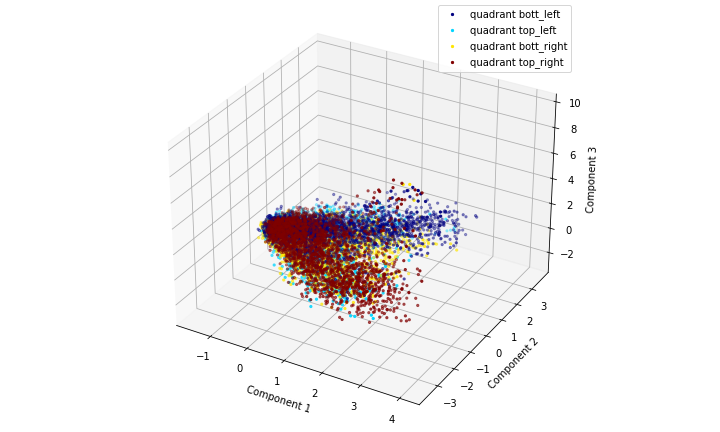

In [175]:
### 3D FA PLOT - INTERACTIVE ###
%matplotlib widget

dimred_type = 'FA'
dimred_loaded = load_dimred_ts(dimred_type, FA_folder)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type, list_names_quadrants, color_map)

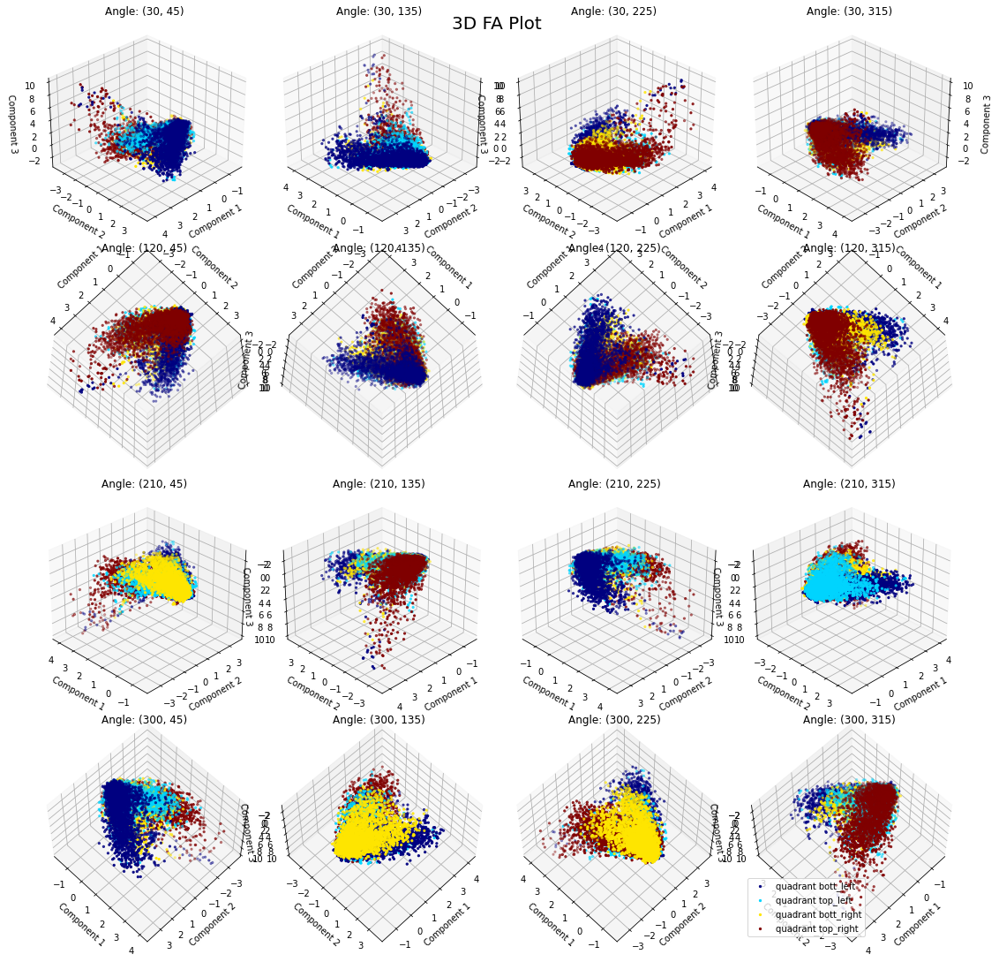

In [176]:
### 3D FA PLOT - MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'FA'
dimred_loaded = load_dimred_ts(dimred_type, FA_folder)
name_plot = f'3D_plot_{dimred_type}_multiple_angles_{suffix_info}{file_ext}'

plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, FA_folder)

# FA consideration

## LOCALLY LINEAR EMBEDDING (LLE) SECTION

In [177]:
### LLE PARAMETERS AND SAVING ###  

LLE_folder = os.path.join(result_folder, "LLE_results")
if not os.path.exists(LLE_folder):
    os.makedirs(LLE_folder)

In [178]:
### LLE - LOCALLY LINEAR EMBEDDING ###

dimred_type = 'LLE'
n_components = n_dim    # Int, default == 2   
n_neighbors = 5         # Int, default == 5

# Create an instance of LocallyLinearEmbedding
lle = LocallyLinearEmbedding(n_components=n_components, n_neighbors=n_neighbors)

# Fit and transform the neu_act data
X_LLE = lle.fit_transform(neu_act)

file_path_lle = os.path.join(LLE_folder, f"{name_file}_{dimred_type}_{params_name}={n_neighbors}_{suffix_info}.npz") 
np.savez(file_path_lle, arr=X_LLE)

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


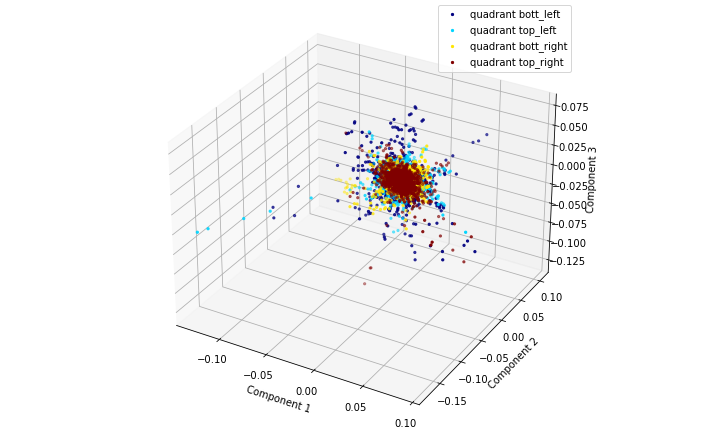

In [181]:
### 3D FA PLOT - INTERACTIVE ###
%matplotlib widget

n_neighbors = 5  
dimred_loaded = load_single_param_dimred(LLE_folder, dimred_type, params_name, n_neighbors)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type, list_names_quadrants, color_map)

In [ ]:
### LLE EXECUTION MULTIPLE PARAMETERS ###

list_n_neighbors = [2, 5, 10, 50]
dimred_type = 'LLE'
params_name = 'neighb'

for i in range(len(list_n_neighbors)):    
    lle = LocallyLinearEmbedding(n_components=n_components, n_neighbors=list_n_neighbors[i])
    X_LLE = lle.fit_transform(neu_act)

    file_path_isomap = os.path.join(LLE_folder, f"{name_file}_{dimred_type}_{params_name}={list_n_neighbors[i]}_{suffix_info}.npz") #_radius={radius}
    np.savez(file_path_isomap, arr=X_LLE)
    print(f"iteration {i} done")


iteration 0 done
iteration 1 done
iteration 2 done
iteration 3 done


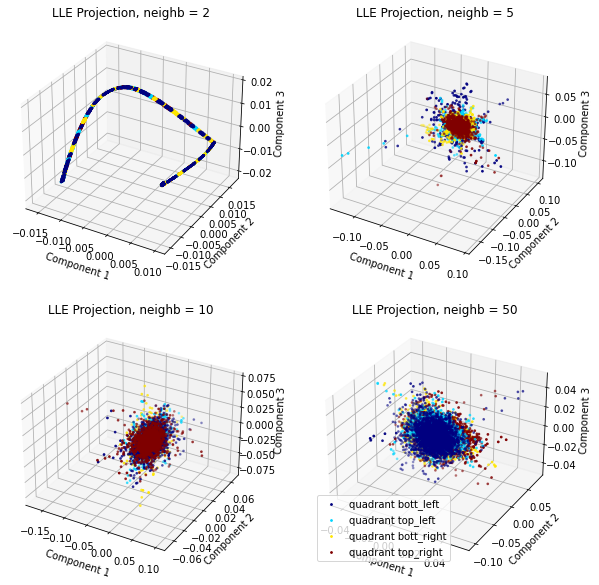

In [ ]:
### 3D LLE PLOT MULTI PARAMETERs - STATIC ###
%matplotlib inline

dimred_arr_list = load_multi_param_dimred(LLE_folder, dimred_type, list_n_neighbors, params_name)

name_plot = f'3D_plot_{dimred_type}_multiple_negh{list_n_neighbors}_{suffix_info}{file_ext}'
plots_3D_fix_angle_multi_param(dimred_arr_list, target_2x2, dimred_type, name_plot, LLE_folder, list_n_neighbors, params_name, list_names_quadrants, color_map, size_dots=size_dots)


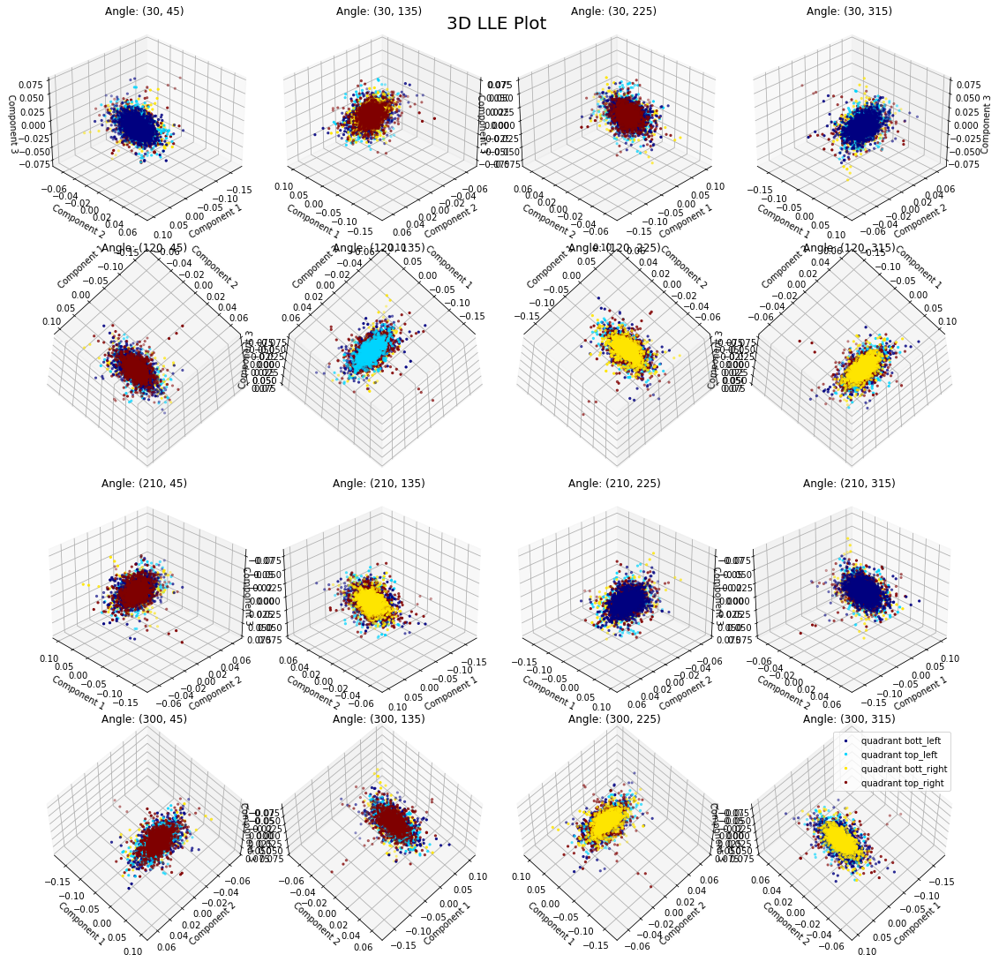

In [ ]:
### 3D LLE PLOT - MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'LLE'
num_neighb = 10
dimred_loaded = load_single_param_dimred(LLE_folder, dimred_type, params_name, num_neighb)

name_plot = f'3D_plot_{dimred_type}_{params_name}={num_neighb}_multiple_angles_{suffix_info}{file_ext}'
plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, LLE_folder)

# LLE consideration

## LINEAR DISCRIMINANT ANALYSIS (LDA) SECTION

In [ ]:
### LDA SAVING ###

LDA_folder = os.path.join(result_folder, "LDA_results")
if not os.path.exists(LDA_folder):
    os.makedirs(LDA_folder)

In [ ]:
### LDA - LINEAR DISCRIMINANT ANALYSIS ###

# Create an instance of LinearDiscriminantAnalysis
lda = LinearDiscriminantAnalysis()

# Fit the LDA model to the data
lda.fit(neu_act, target_2x2)

# Transform the data to the LDA space
X_LDA = lda.transform(neu_act)

dimred_type = 'LDA'
file_path_LDA = os.path.join(LDA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
np.savez(file_path_LDA, arr=X_LDA)


C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\740017966.py:9: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


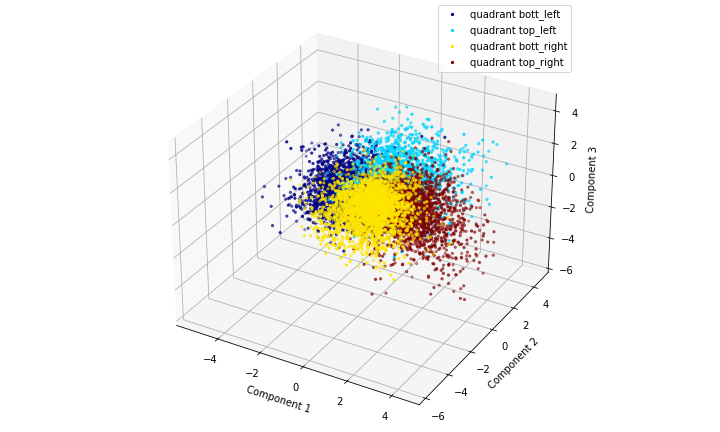

In [ ]:
### 3D FA PLOT - INTERACTIVE ###
%matplotlib widget

dimred_type = 'LDA'
dimred_loaded = load_dimred_ts(dimred_type, LDA_folder)

plots_3D_interactive(dimred_loaded, target_2x2, dimred_type, list_names_quadrants, color_map)

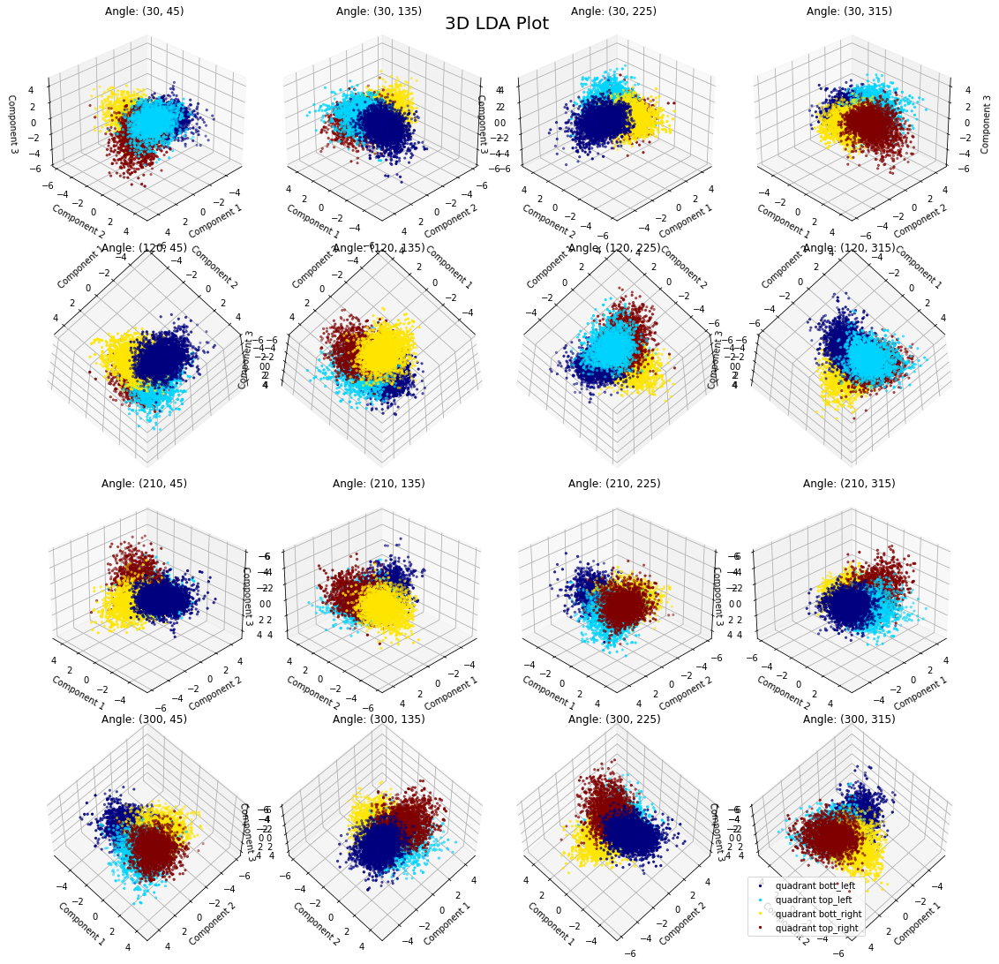

In [ ]:
### 3D LDA PLOT - MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'LDA'
dimred_loaded = load_dimred_ts(dimred_type, LDA_folder)

name_plot = f'3D_plot_{dimred_type}_multiple_angles_{suffix_info}{file_ext}'
plots_3D_multiple_angles(dimred_loaded, target_2x2, dimred_type, name_plot, LDA_folder)

# LLA consideration

# Comparison dimensionality reduction methods

# Mean trajectory peristimulus 
## Why do so?
- Can you find good reasons for being interested only in the moments before the monkey reaches the target? 
- Is your hypotesis matching the results below? 

In [ ]:
### FUNCTION: MEAN PERISTIMULUS TIME SERIES ###

def create_mean_ts(neu_act, target_2x2):
    '''
    Description: This function creates a list with the mean time series of the neural activity per category of the trials.
    input:
    - neu_act: array of shape (n_time_bins, n_neurons) with the neural activity
    - target_2x2: array of shape (n_time_bins,) with the target position discretized in a 2x2 grid
    output:
    - collect_all_mean_ts: list of arrays with the mean time series of the neural activity per category of the trials
    - ts_min_len_list: list of trials of arrays with the time series of the neural activity per category of the trials
    Note: the snippets is aligned from the end of the trial
    '''

    n_input = np.unique(target_2x2).size
    indices = np.where(np.diff(target_2x2)!=0)[0]  # find the indices where the target changes

    assert indices[0] > 20, "The first target change is too close to the beginning of the time series"
    min_len = np.min(np.diff(indices)) - 1  # find the minimum length of the time series aligned with the end
    trial_type=target_2x2[indices]  # find category corresponding to the indices the target change

    # Create a list with the mean across trial of time series per category
    # Find the indices of the corresponding category and create the vector. 
    # Create the time series with the neural activity of minimal length aligned with the end. 
    # Finally append the mean of it in a list 

    ts_min_len_list = [] # list of trials, for matte's code  
    collect_all_mean_ts=[]
    for i in range(n_input):
        ts_min_len_list.append([])
        collect_all_mean_ts.append([])
        trial_X=indices[np.where(trial_type==i)[0]]
        ts_min_len = np.ndarray(shape=(len(trial_X), min_len, neu_act.shape[1]))
        for t in range(len(trial_X)):
            ts_min_len[t,:,:] = neu_act[trial_X[t]-min_len:trial_X[t],:]
            ts_min_len_list[i].append(neu_act[trial_X[t]-min_len:trial_X[t],:])
        mean_ts_X=np.mean(ts_min_len,axis=0)
        collect_all_mean_ts[i] = mean_ts_X
    
    return collect_all_mean_ts, ts_min_len_list

In [ ]:
### FUNCTION: PLOT MEAN TRAJECTORY ###

def plot_mean_trajectory_3D(collect_all_mean_ts, n_input, color_map, list_names_quadrants):
    ''' 
    '''

    fig = plt.figure(figsize=(10, 6))
    ax = Axes3D(fig)

    for i in range(n_input):
        ax.plot(collect_all_mean_ts[i][:,0], collect_all_mean_ts[i][:,1], collect_all_mean_ts[i][:,2], color=color_map(i),label=f"quadrant {list_names_quadrants[i]}")#, s=10)
        ax.scatter(collect_all_mean_ts[i][0,0], collect_all_mean_ts[i][0,1], collect_all_mean_ts[i][0,2], color=color_map(i), s=50)
        ax.scatter(collect_all_mean_ts[i][-1,0], collect_all_mean_ts[i][-1,1], collect_all_mean_ts[i][-1,2], marker = '^', color=color_map(i), s=50)
    ax.scatter(collect_all_mean_ts[i][0,0], collect_all_mean_ts[i][0,1], collect_all_mean_ts[i][0,2], color=color_map(i), s=50, label=f"start {list_names_quadrants[i]}")
    ax.scatter(collect_all_mean_ts[i][-1,0], collect_all_mean_ts[i][-1,1], collect_all_mean_ts[i][-1,2], marker = '^', color=color_map(i), s=50, label=f"end {list_names_quadrants[i]}")
    
    ax.set_xlabel('Component 1')
    ax.set_ylabel('Component 2')
    ax.set_zlabel('Component 3')
    ax.set_title(f'3D {dimred_type} Plot')
    plt.legend()
    plt.show()

In [ ]:
### FUNCTION: PSTH PLOTS (FROM MATTEO), SELECTIONABLE NEURONS IN A LIST  

# list of 4 elements [[arr_trl1_cat0, arr_trl2_cat0,...], [arr_trl1_cat1, arr_trl2_cat1,...],...n_category...[]]
# inside each list a numpy array shape (T, N)
# ax_list_observab => initialize the figure and axes (the number of the axes is..
# ..the number of rows and columns of the subplot and must correspond to the number of observables)

def plot_mean_traj_ofOBS_per_task(data_listTASK_listTRIALS_npT_dx, ax_list_observab,nomi_task=None,colours_task=None,nomi_observab=None,list_obs_to_print=None):
    #data is a list of #TASKS elements, each of which is list of #TRIALS element containing  numpy array of shape  T x dObservables
    assert len(ax_list_observab)>=len(list_obs_to_print) or len(ax_list_observab)==data_listTASK_listTRIALS_npT_dx[0][0].shape[1], "Number of observables in ax_list_observab must be equal to the number of observables in the data"
    assert nomi_observab==None or len(nomi_observab)==data_listTASK_listTRIALS_npT_dx[0][0].shape[1], "Number of observables in nomi_observab must be equal to the number of observables in the data"
    if list_obs_to_print==None:
        list_obs_to_print=range(data_listTASK_listTRIALS_npT_dx[0][0].shape[1])
    if nomi_task==None:
        nomi_task=[f"Task {i}" for i in range(len(data_listTASK_listTRIALS_npT_dx))]
    nomi_task=[nt+f"({len(data_listTASK_listTRIALS_npT_dx[k])})" for k,nt in enumerate(nomi_task)]
    if colours_task==None:
        colours_task=['C'+str(i) for i in range(len(data_listTASK_listTRIALS_npT_dx))]
    if nomi_observab==None:
        nomi_observab=[f"Observable {i}" for i in range(data_listTASK_listTRIALS_npT_dx[0][0].shape[1])]
    mean_traj_list=[]
    std_traj_list=[]
    TIME=data_listTASK_listTRIALS_npT_dx[0][0].shape[0]
    for kk_task in range(len(data_listTASK_listTRIALS_npT_dx)):
        data = data_listTASK_listTRIALS_npT_dx[kk_task]
        mean = np.mean(data, axis=0)
        std = np.std(data, axis=0)
        upper_bound = mean + std
        lower_bound = mean - std
        
        for i_plot,i_obs in enumerate(list_obs_to_print):
            ax=ax_list_observab[i_plot]
            ax.plot(range(TIME), mean[:,i_obs], label=nomi_task[kk_task],color=colours_task[kk_task],linestyle='dashed')
            ax.fill_between(range(TIME), lower_bound[:,i_obs], upper_bound[:,i_obs],alpha=0.15,color=colours_task[kk_task])
            ax.legend()
            #ax.show();
            ax.set_title(nomi_observab[i_obs])
        mean_traj_list.append(mean.copy())
        std_traj_list.append(std.copy())
    #return the list of mean trajecories and std_dev_trajectories, with each element a numpy array of size T x dOBSERV 
    return mean_traj_list,std_traj_list

plot 0 done
plot 1 done
plot 2 done
plot 3 done
plot 4 done
plot 5 done
plot 6 done
plot 7 done
plot 8 done
plot 9 done
plot 10 done
plot 11 done
plot 12 done
plot 13 done


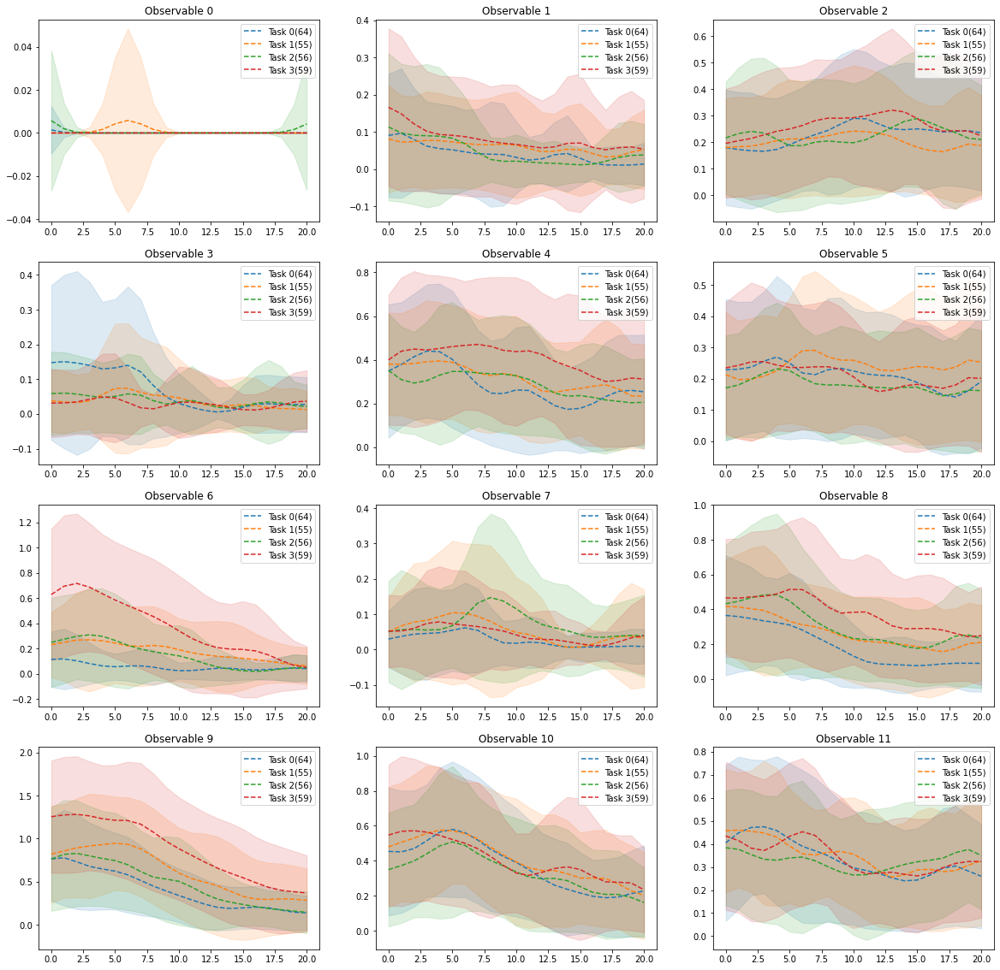

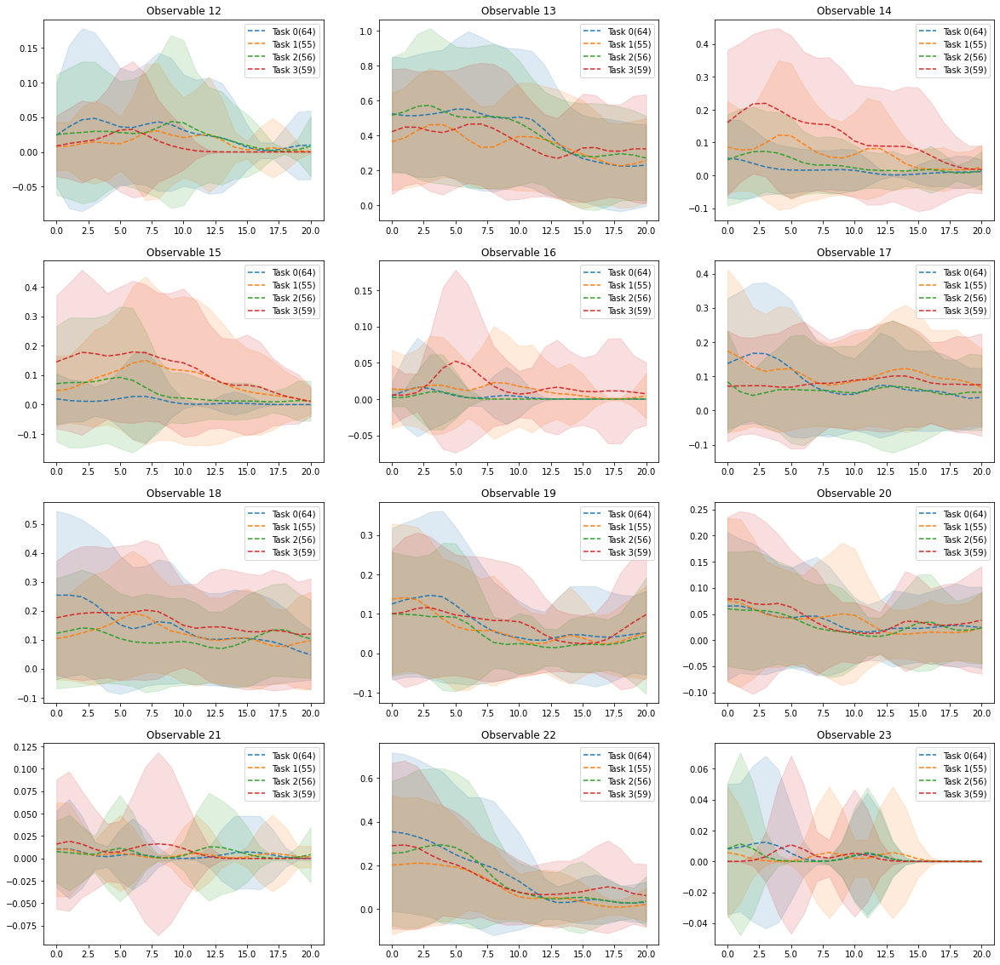

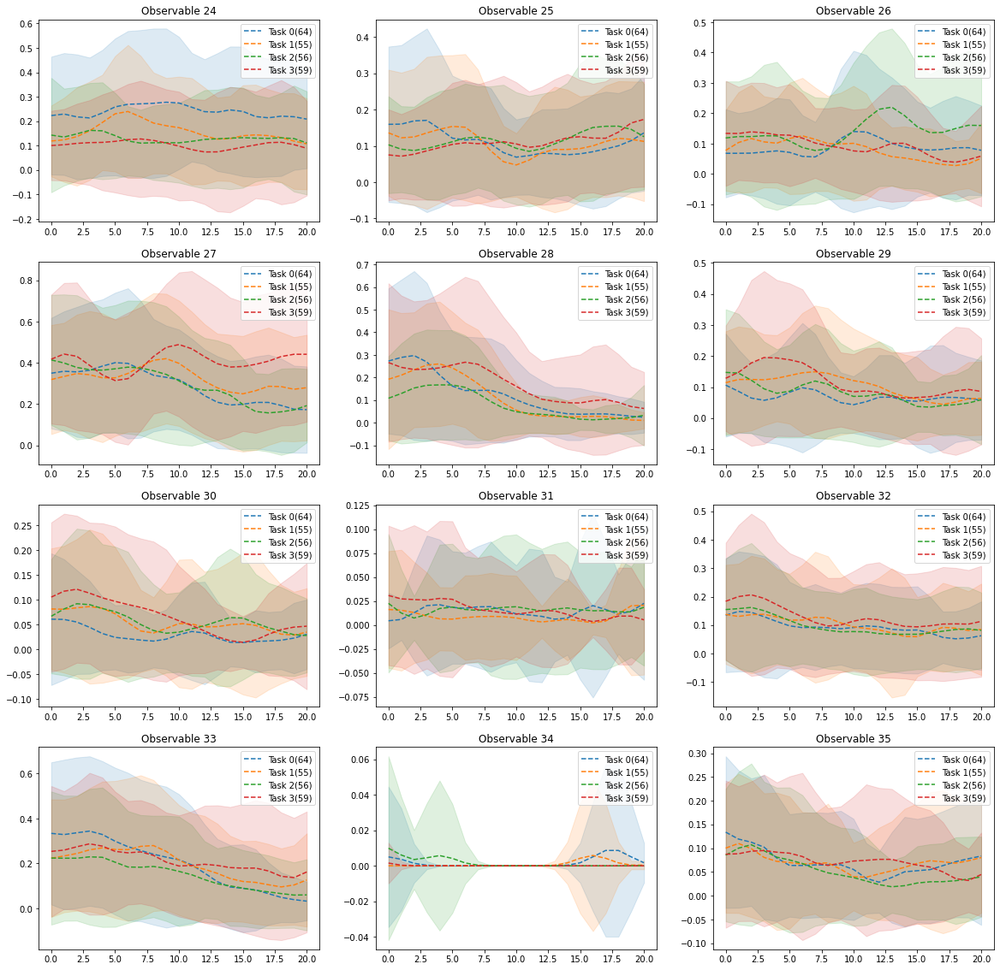

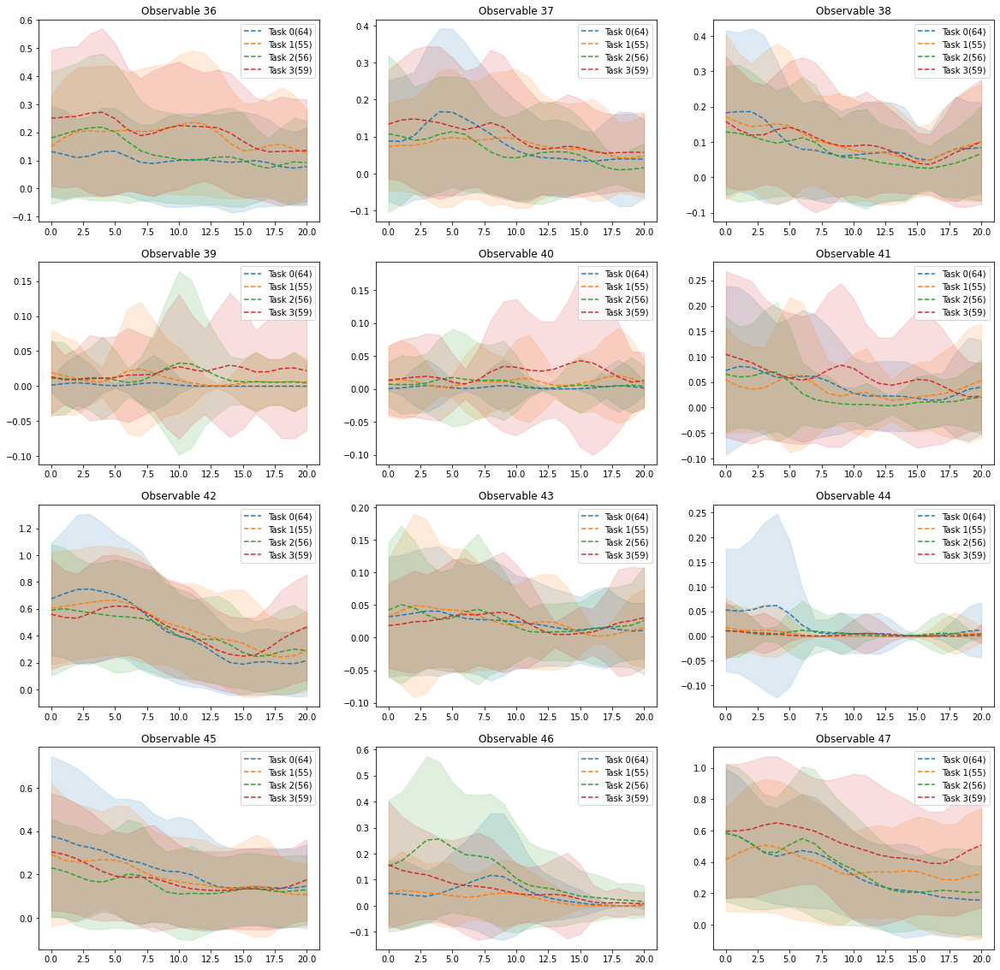

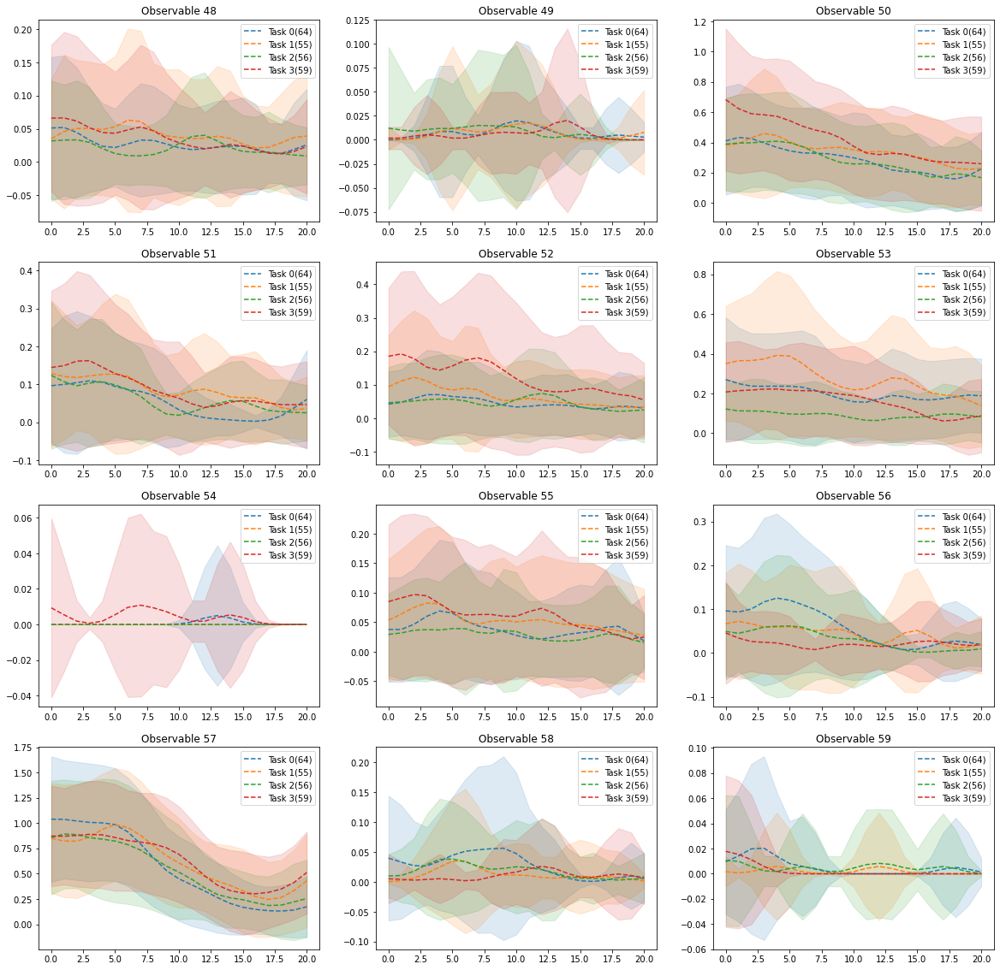

...

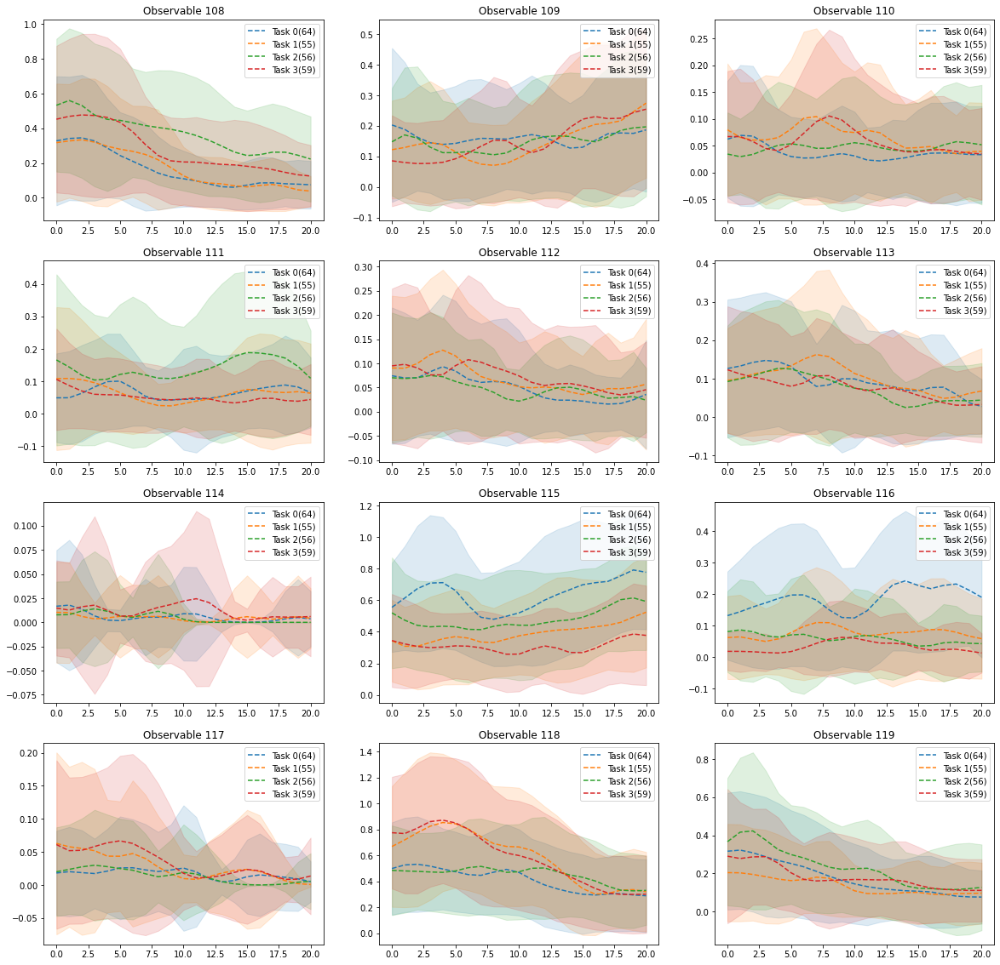

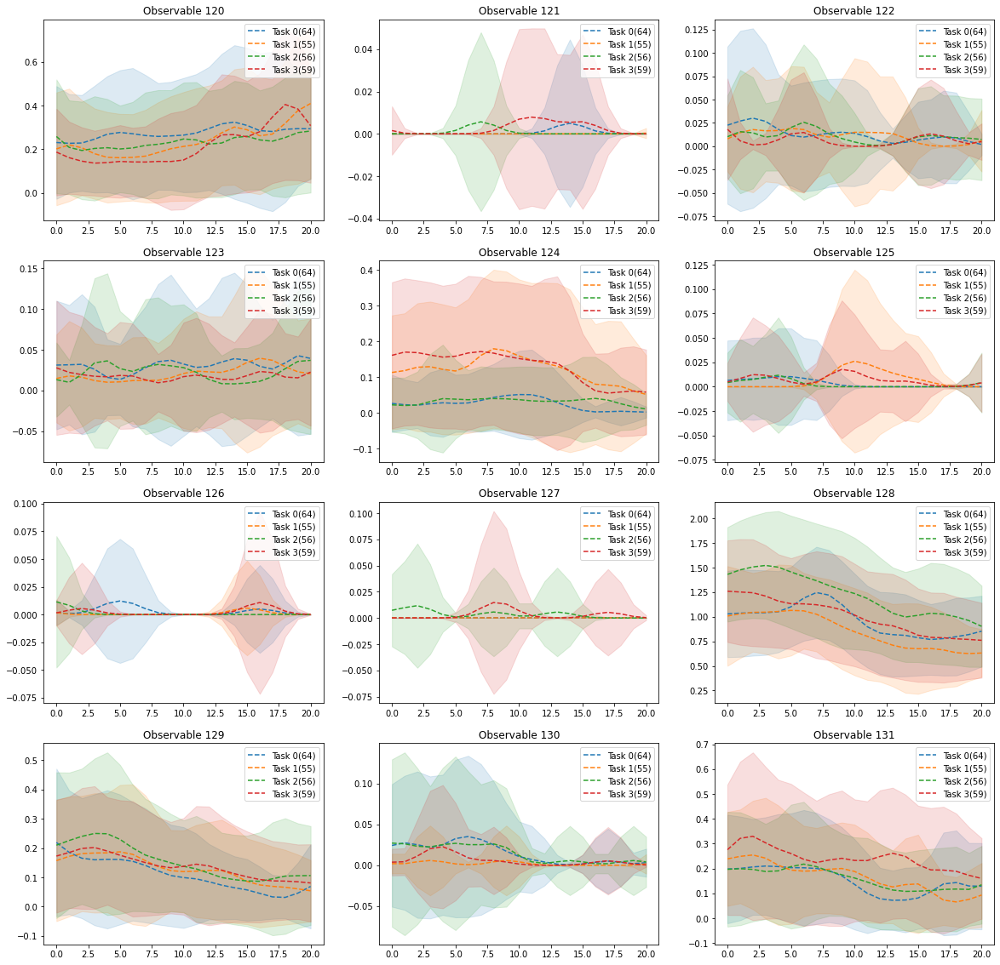

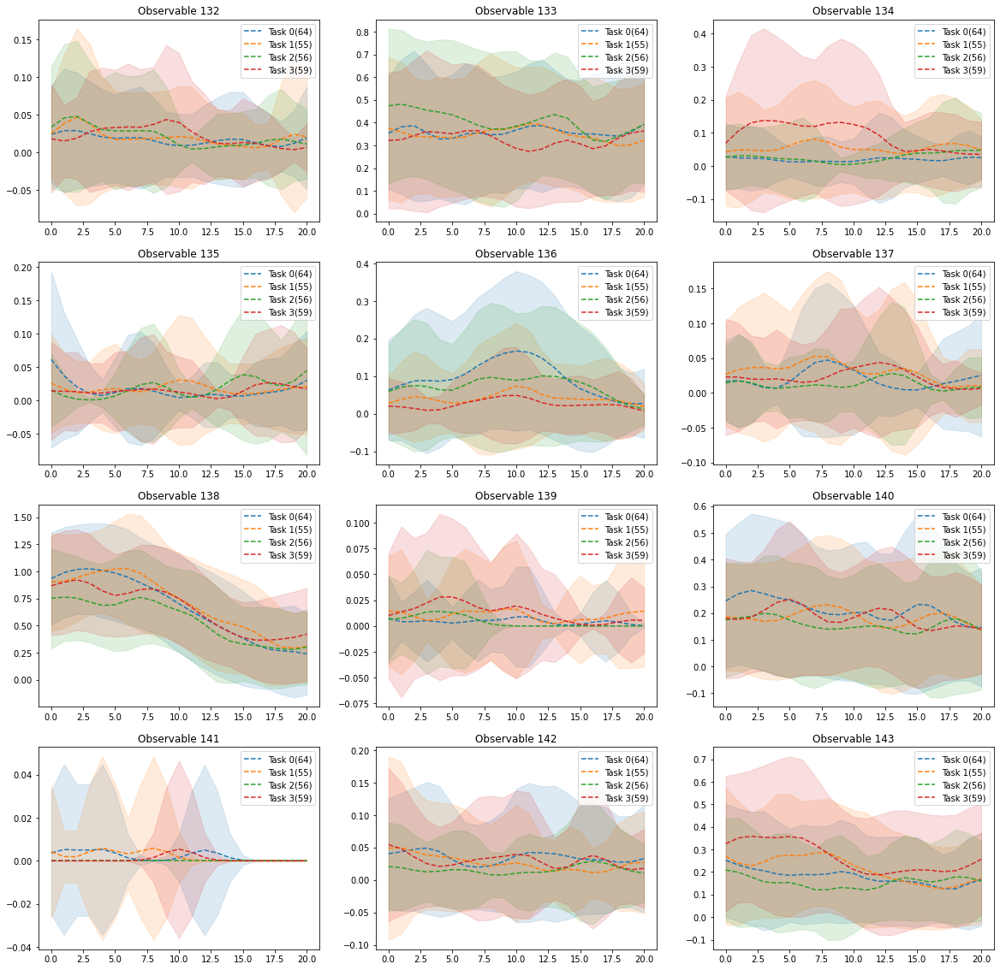

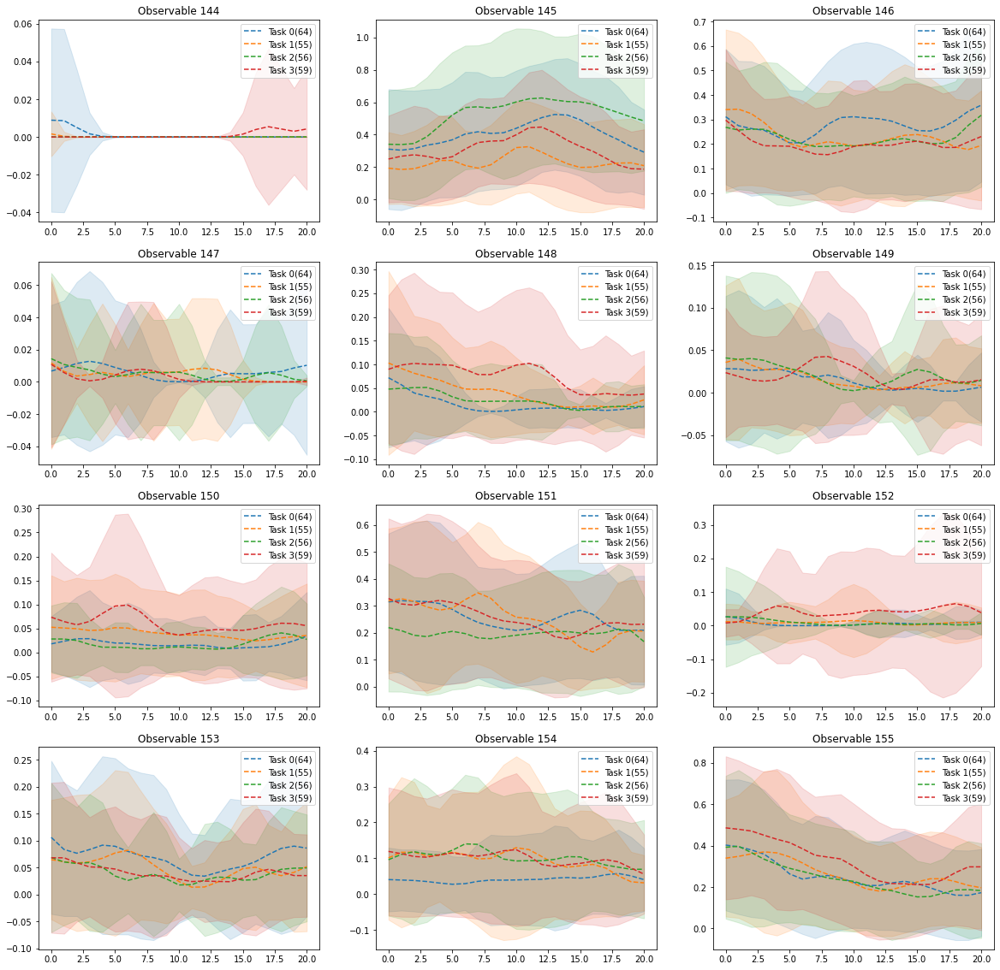

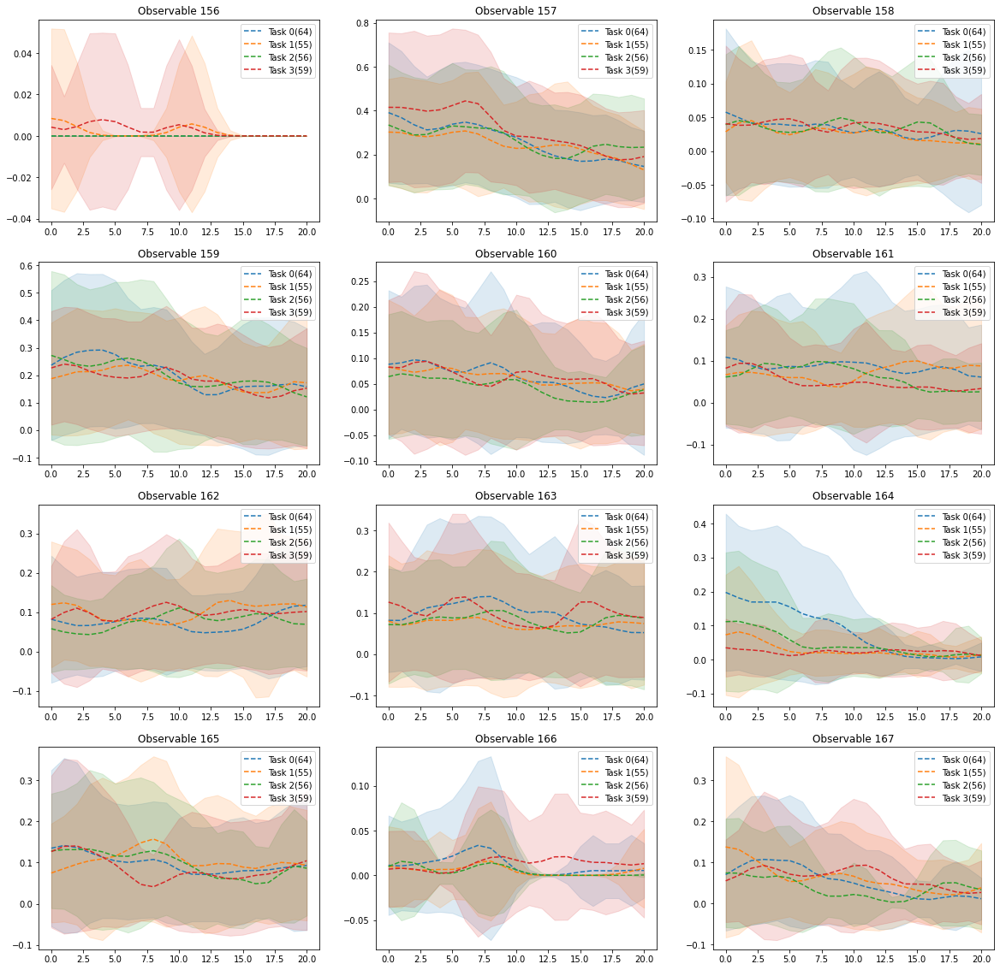

In [ ]:
### PLOT AND SAVE PSTH FOR ALL NEURONS ###

n_neur = neu_act.shape[1] # Number of neurons
t_plot = neu_act.shape[0]  # Number of time points to plot from the test set
suffix_neurons_time = f"neurons{n_neur}_time{t_plot}"

# folder 
psth_folder = "psth_plots"
if not os.path.exists(psth_folder):
    os.makedirs(psth_folder)

# generate list of ts
mean_ts_X, ts_min_len_list = create_mean_ts(neu_act, target_2x2) # list of arrays with the mean time series of the neural activity per category of the trials

#plot and save
for i in range(int(178/12)):
    fig, ax = plt.subplots(4,3,figsize=(20,20)) #  (n,m) nxm = numero osservabili neuroni 
    means_trajs,std= plot_mean_traj_ofOBS_per_task(ts_min_len_list, ax.flatten(),list_obs_to_print=np.arange(i*12,(i+1)*12).tolist())
    plt.savefig(psth_folder + f"/no_std_neurons{i*12}to{(i+1)*12}_{suffix_neurons_time}{file_ext}" ,dpi=300, bbox_inches='tight')
    print(f'plot {i} done')

### PCA mean trajectory

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\1569832884.py:8: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


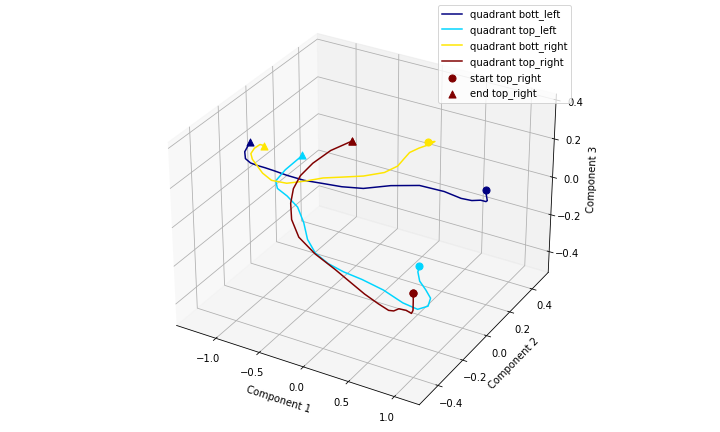

In [ ]:
### 3D PLOT PCA MEAN TRAJECTORY ###
%matplotlib widget 

dimred_type = 'PCA'
file_path_PCA = os.path.join(pca_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_pca_loaded = np.load(file_path_PCA)['arr']
pca_mean_ts, pca_ts_list = create_mean_ts(X_pca_loaded, target_2x2)

plot_mean_trajectory_3D(pca_mean_ts, n_input, color_map, list_names_quadrants)

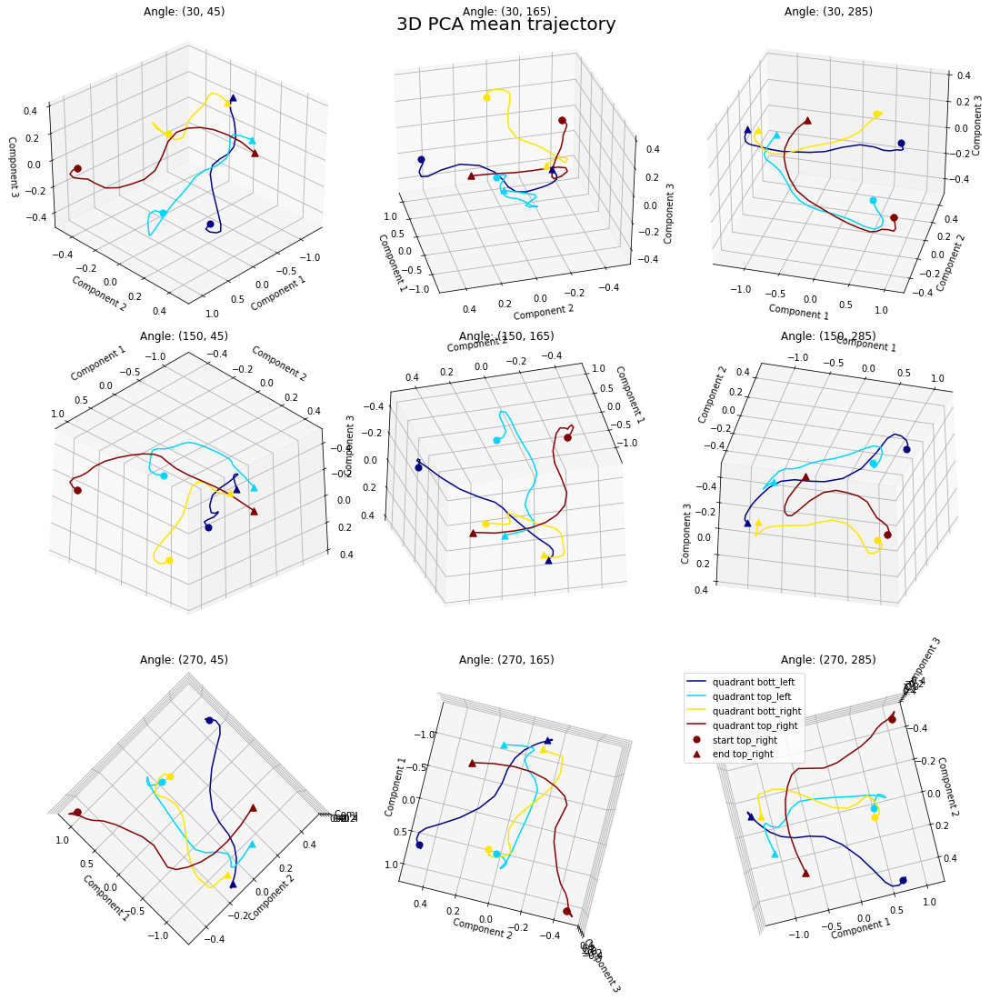

In [ ]:
### 3D PLOT PCA MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'PCA'
file_path_PCA = os.path.join(pca_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_pca_loaded = np.load(file_path_PCA)['arr']
pca_mean_ts, pca_ts_list = create_mean_ts(X_pca_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(pca_mean_ts, dimred_type, name_plot, pca_folder, list_names_quadrants, color_map)


### ISOMAP mean trajectory

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\1569832884.py:8: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


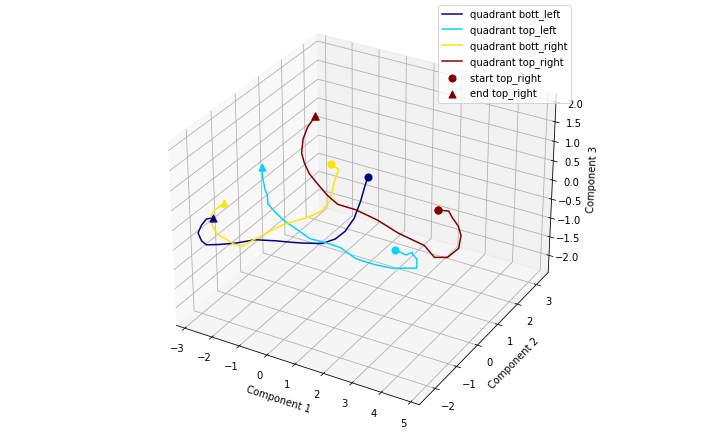

In [ ]:
### 3D PLOT ISOMAP MEAN TRAJECTORY - INTERACTIVE ###  
%matplotlib widget 

num_neighb = 5
dimred_type = 'ISOMAP'
params_name = 'neighb'
isomap_loaded = load_single_param_dimred(ISOMAP_folder, dimred_type, params_name, num_neighb, suffix_info)
isomap_mean_ts, isomap_ts_list = create_mean_ts(isomap_loaded, target_2x2)

plot_mean_trajectory_3D(isomap_mean_ts, n_input, color_map, list_names_quadrants)

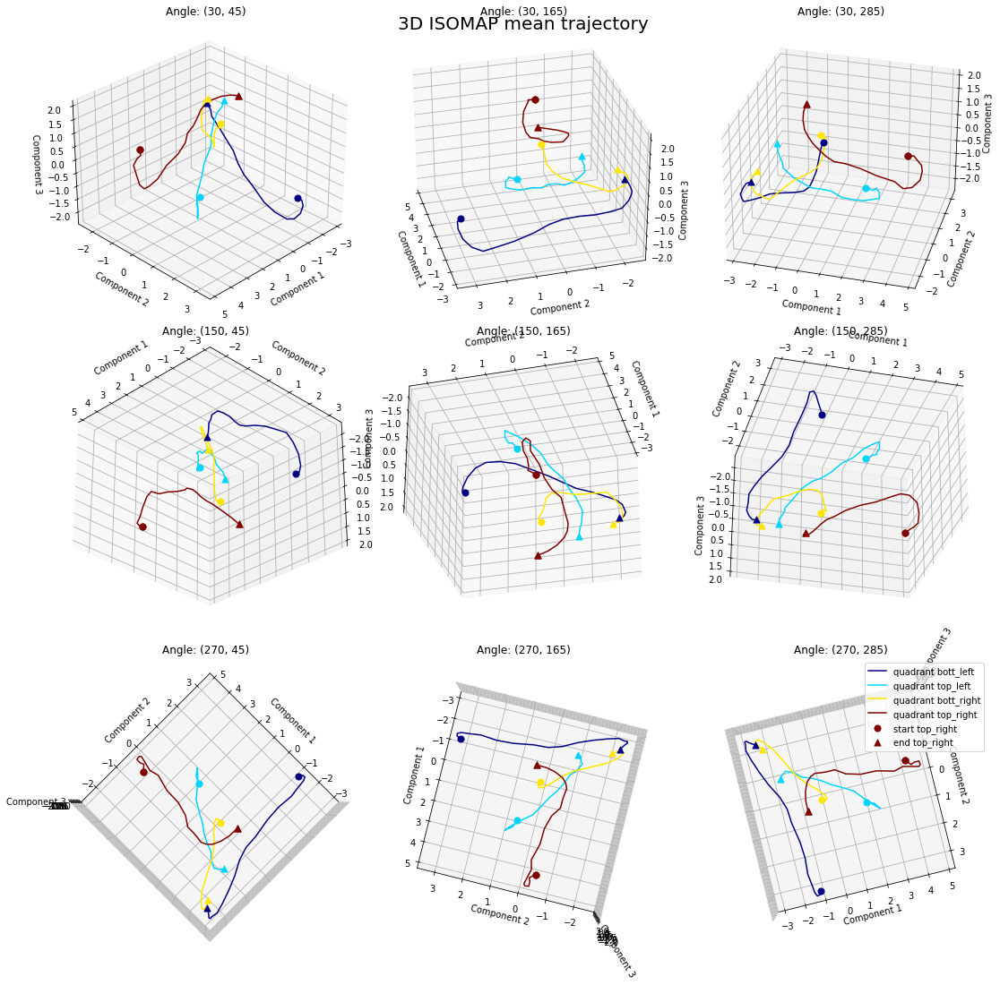

In [ ]:
### 3D PLOT ISOMAP MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

num_neighb = 5
dimred_type = 'ISOMAP'
params_name = 'neighb'

isomap_loaded = load_single_param_dimred(ISOMAP_folder, dimred_type, params_name, num_neighb, suffix_info)
isomap_mean_ts, isomap_ts_list = create_mean_ts(isomap_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{params_name}={num_neighb}_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(isomap_mean_ts, dimred_type, name_plot, ISOMAP_folder, list_names_quadrants, color_map)


### ICA mean trajectory

In [ ]:
### 3D PLOT ICA MEAN TRAJECTORY INTERACTIVE ###  
%matplotlib widget 

dimred_type = 'ICA'

file_path_ICA = os.path.join(ICA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_ICA_loaded = np.load(file_path_ICA)['arr']
ica_mean_ts, ica_ts_list = create_mean_ts(X_ICA_loaded, target_2x2)

plot_mean_trajectory_3D(ica_mean_ts, n_input, color_map, list_names_quadrants)

NameError: name 'create_mean_ts' is not defined

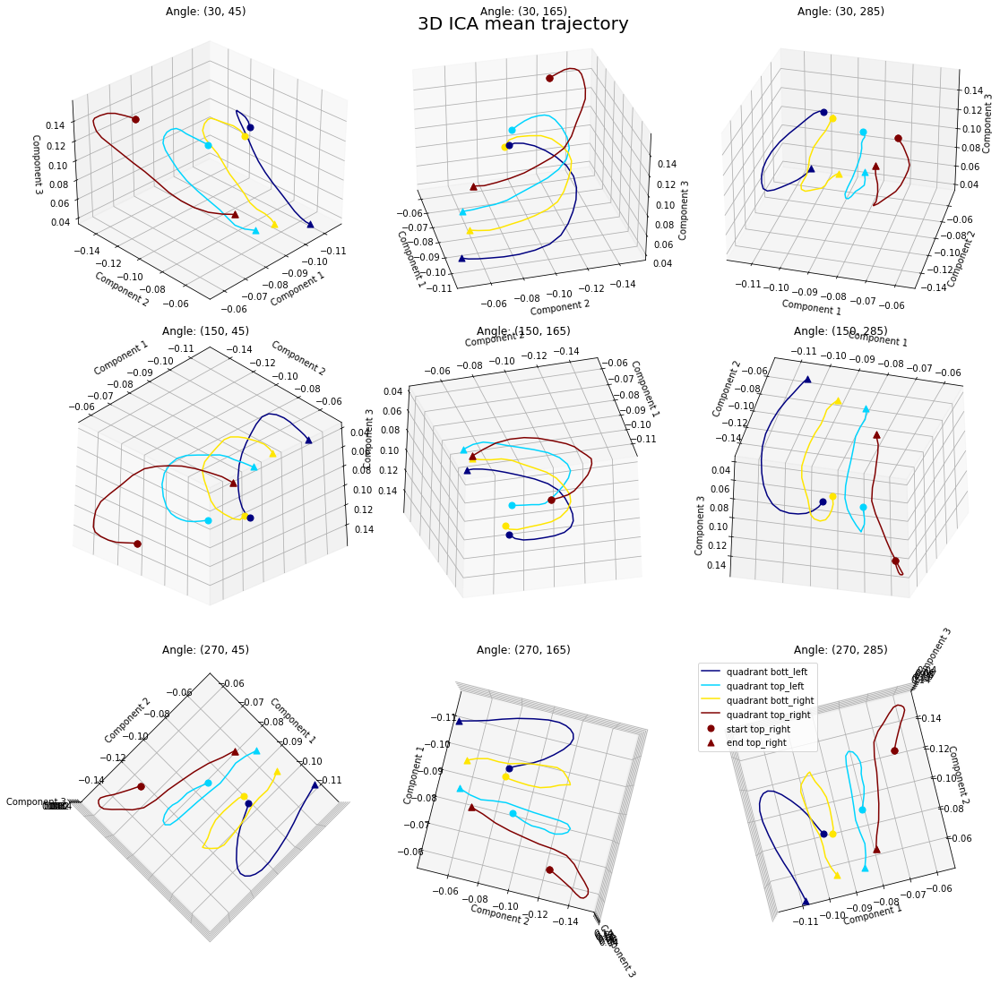

In [ ]:
### 3D PLOT ICA MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'ICA'

file_path_ICA = os.path.join(ICA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_ICA_loaded = np.load(file_path_ICA)['arr']
ica_mean_ts, ica_ts_list = create_mean_ts(X_ICA_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(ica_mean_ts, dimred_type, name_plot, ICA_folder, list_names_quadrants, color_map)


### FA mean trajectory

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\1569832884.py:8: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


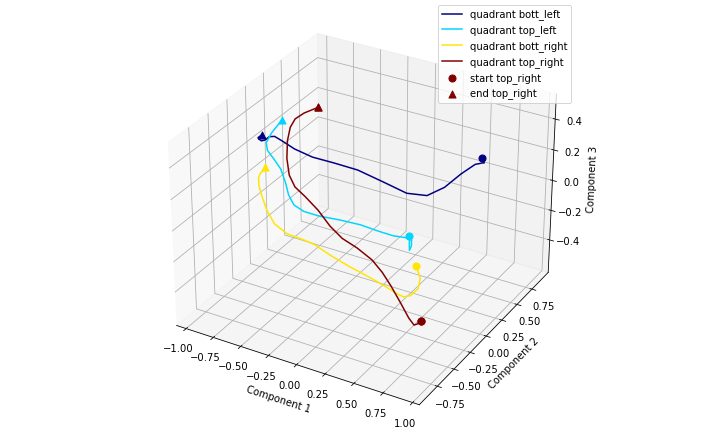

In [ ]:
### 3D PLOT ICA MEAN TRAJECTORY INTERACTIVE ###  
%matplotlib widget 

dimred_type = 'FA'

file_path_FA = os.path.join(FA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_FA_loaded = np.load(file_path_FA)['arr']
fa_mean_ts, fa_ts_list = create_mean_ts(X_FA_loaded, target_2x2)

plot_mean_trajectory_3D(fa_mean_ts, n_input, color_map, list_names_quadrants)

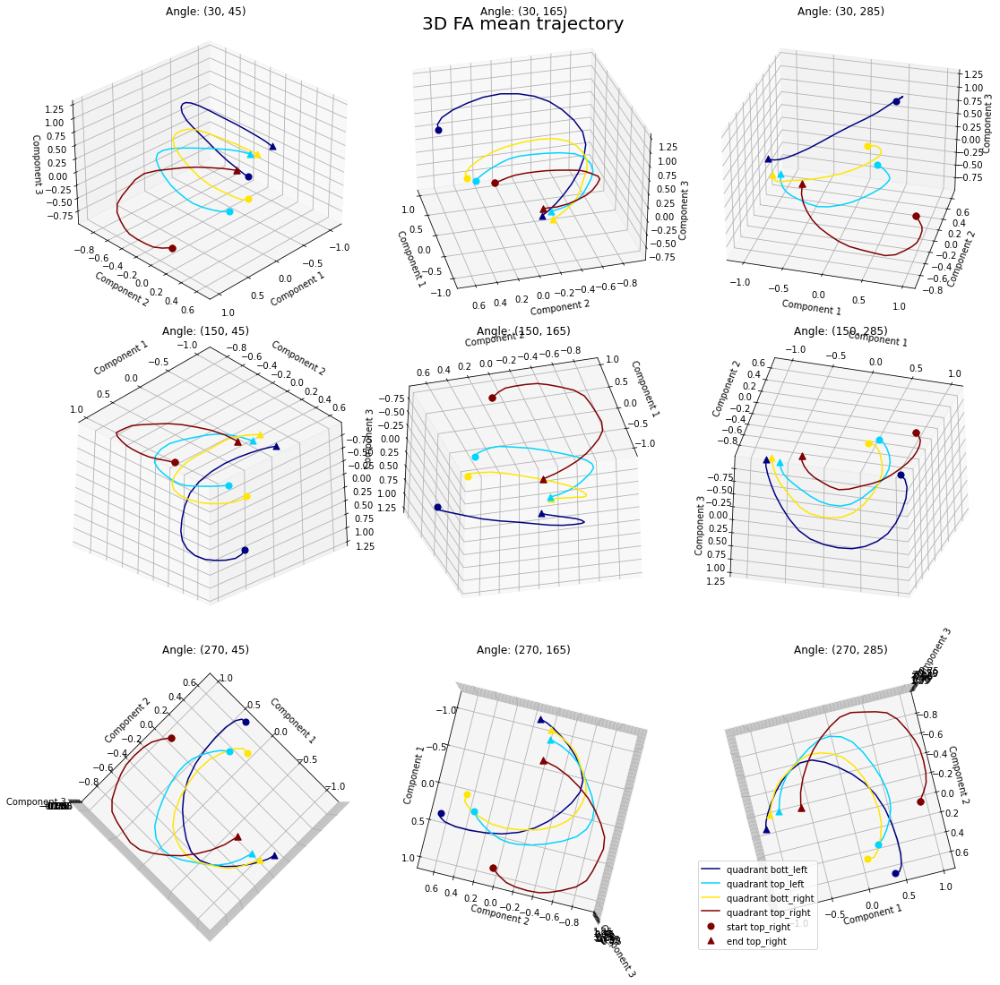

In [ ]:
### 3D PLOT FA MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'FA'

file_path_FA = os.path.join(FA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_FA_loaded = np.load(file_path_FA)['arr']
fa_mean_ts, fa_ts_list = create_mean_ts(X_FA_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(fa_mean_ts, dimred_type, name_plot, FA_folder, list_names_quadrants, color_map)


### LLE mean trajectory

C:\Users\pceo\AppData\Local\Temp\ipykernel_16632\1569832884.py:8: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


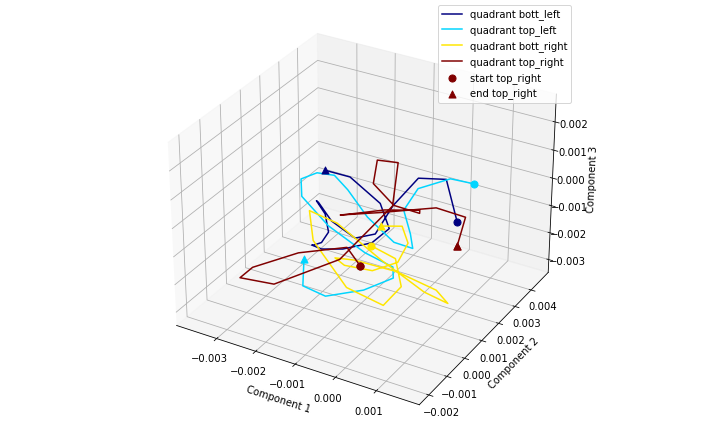

In [ ]:
### 3D PLOT LLE MEAN TRAJECTORY INTERACTIVE ###  
%matplotlib widget 

dimred_type = 'LLE'
num_neighb = 5
dimred_loaded = load_single_param_dimred(LLE_folder, dimred_type, params_name, num_neighb)

lle_mean_ts, lle_ts_list = create_mean_ts(dimred_loaded, target_2x2)

plot_mean_trajectory_3D(lle_mean_ts, n_input, color_map, list_names_quadrants)

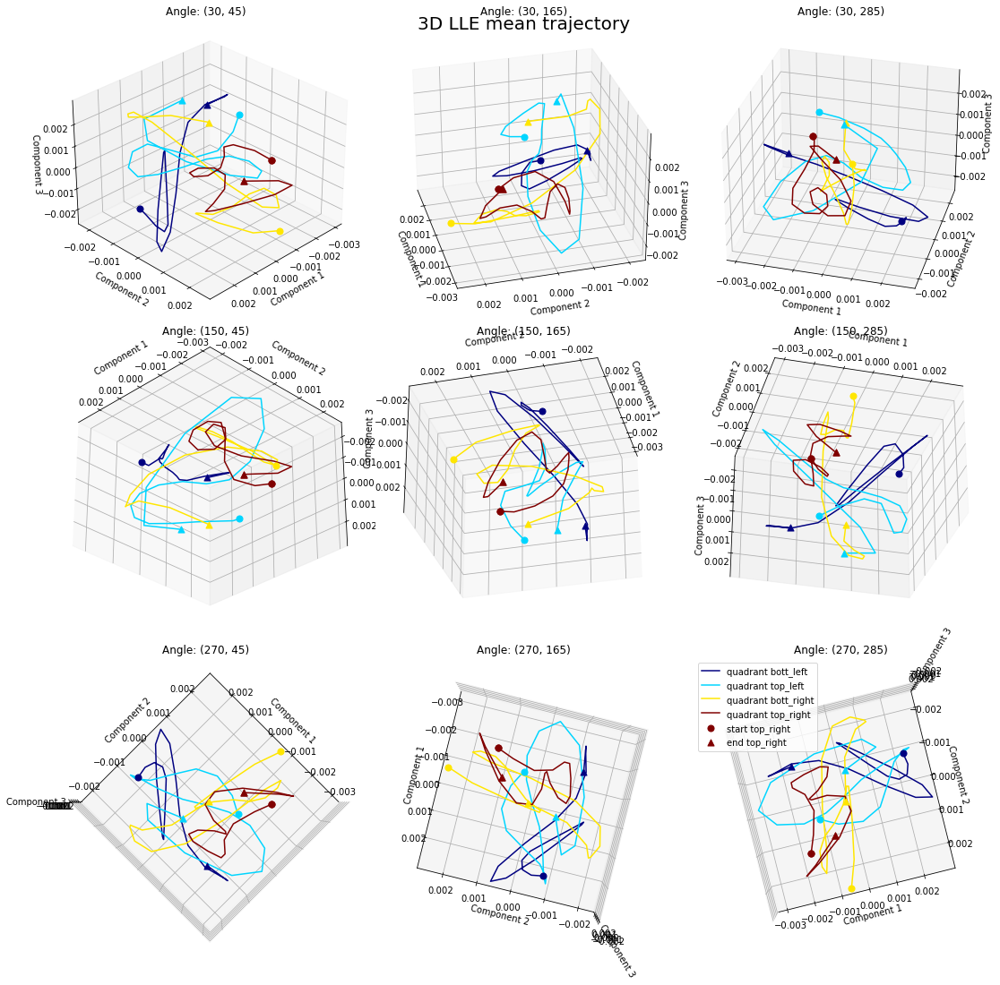

In [ ]:
### 3D PLOT LLE MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'LLE'
num_neighb = 5
dimred_loaded = load_single_param_dimred(LLE_folder, dimred_type, params_name, num_neighb)

lle_mean_ts, lle_ts_list = create_mean_ts(dimred_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(lle_mean_ts, dimred_type, name_plot, LLE_folder, list_names_quadrants, color_map)


### LDA mean trajectory

C:\Users\pceo\AppData\Local\Temp\ipykernel_3456\1569832884.py:8: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


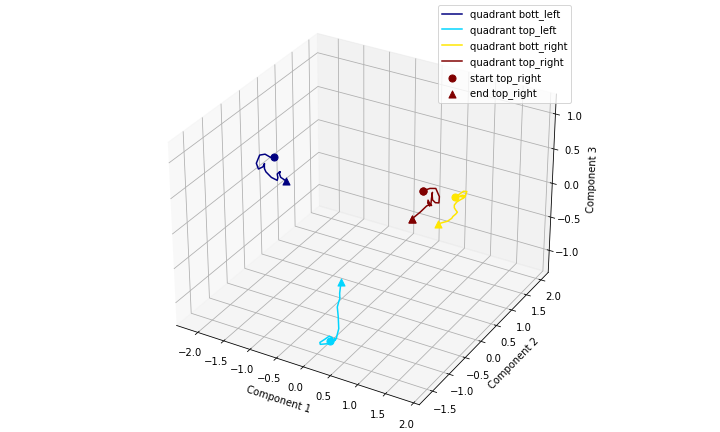

In [ ]:
### 3D PLOT ICA MEAN TRAJECTORY INTERACTIVE ###  
%matplotlib widget 

dimred_type = 'LDA'
file_path_LDA = os.path.join(LDA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_LDA_loaded = np.load(file_path_LDA)['arr']
lda_mean_ts, lda_ts_list = create_mean_ts(X_LDA_loaded, target_2x2)

plot_mean_trajectory_3D(lda_mean_ts, n_input, color_map, list_names_quadrants)

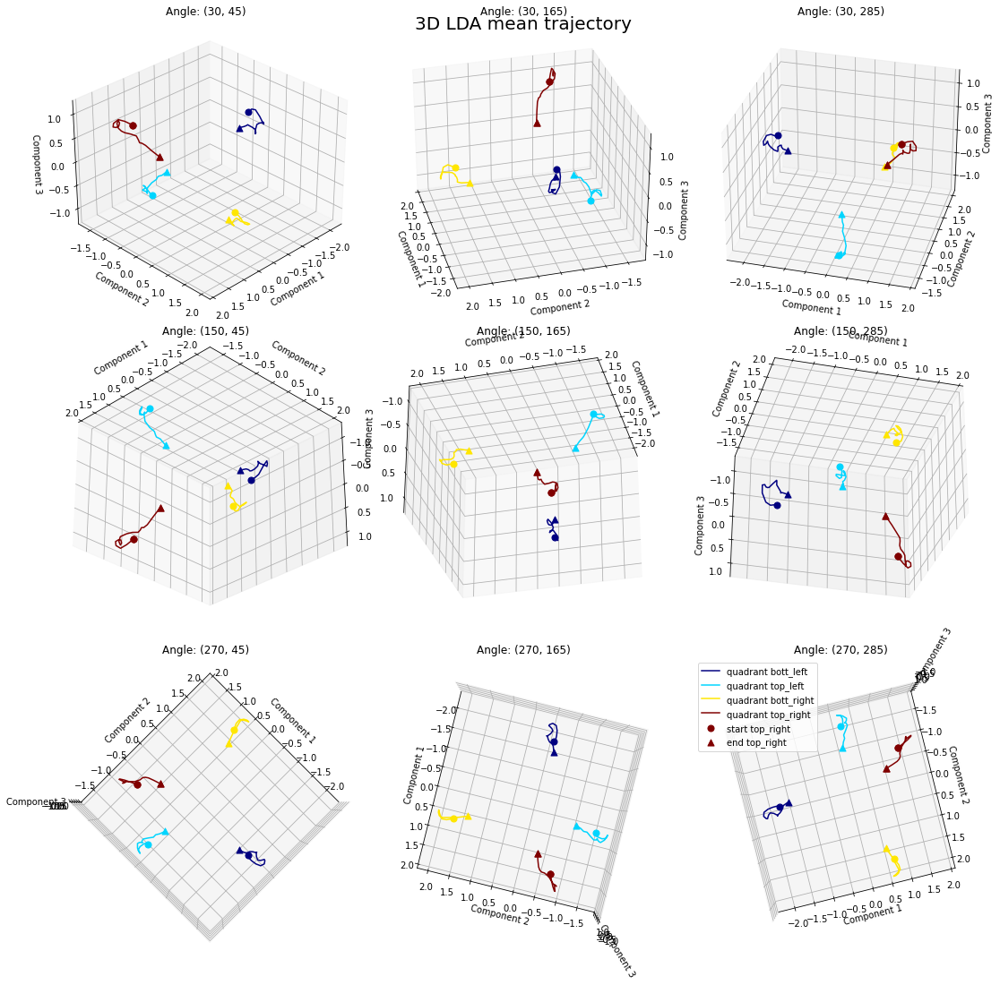

In [ ]:
### 3D PLOT ICA MEAN TRAJECTORY MULTIPLE ANGLES ###
%matplotlib inline

dimred_type = 'LDA'
file_path_LDA = os.path.join(LDA_folder, f"{name_file}_{dimred_type}_{suffix_info}.npz")
X_LDA_loaded = np.load(file_path_LDA)['arr']
lda_mean_ts, lda_ts_list = create_mean_ts(X_LDA_loaded, target_2x2)

name_plot = f'3D_plot_{dimred_type}_mean_traj_multiple_angles_{suffix_info}{file_ext}'
plots_3D_mean_traj_multiple_angles(lda_mean_ts, dimred_type, name_plot, LDA_folder, list_names_quadrants, color_map)


### Final consideration 